In [341]:
from glob import glob
from PIL import Image
from matplotlib import pyplot as plt
import numpy as np
import cv2

import math
from tqdm import tqdm

plt.rcParams["figure.figsize"] = (20,20)

In [342]:
def load_img(path, mask_mul=1):
    cimg = cv2.imread(path)*mask_mul

    img = cv2.cvtColor(cimg,cv2.COLOR_BGR2GRAY)
    img = cv2.medianBlur(img, 5)
    cimg = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    
    return img, cimg

In [343]:
# helper function for data visualization
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(30, 30))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title())
        plt.imshow(image)
    plt.show()

In [468]:
def find_hiplat(fcenter, xray_path):
    left_hip_path = xray_path.replace("png_512", "pr_all_eb3").replace(".png", "_3.png")
    right_hip_path = xray_path.replace("png_512", "pr_all_eb3").replace(".png", "_4.png")
    hip_arr = np.array(Image.open(left_hip_path)) + np.array(Image.open(right_hip_path))
    left_center = fcenter[0]
    right_center = fcenter[1]
    
    l_upmost = int(left_center[1]-left_center[2]*1.1)
    r_upmost = int(right_center[1]-right_center[2]*1.1)

    l_roi = hip_arr[l_upmost:int(left_center[1]-left_center[2]*0.9), :left_center[0]]
    r_roi = hip_arr[r_upmost:int(right_center[1]-right_center[2]*0.9), right_center[0]:]

#     l_roi = hip_arr[l_upmost:int(left_center[1]), :left_center[0]]
#     r_roi = hip_arr[r_upmost:int(right_center[1]), right_center[0]:]
    
    l_most = np.min(np.where(l_roi == 1)[1])
    r_most = np.max(np.where(r_roi == 1)[1])

    l_pos = np.where(np.where(l_roi == 1)[1] == l_most)
    r_pos = np.where(np.where(r_roi == 1)[1] == r_most)

    l_y = int(np.mean(np.where(l_roi == 1)[0][l_pos]))
    r_y = int(np.mean(np.where(r_roi == 1)[0][r_pos]))

    l_hiplat = [l_most, l_y+l_upmost]
    r_hiplat = [right_center[0]+r_most, r_y+r_upmost]

    return l_hiplat, r_hiplat

In [345]:
def draw_point(img, pnt):
    d_img = img.copy()
    cv2.circle(d_img, (pnt[0], pnt[1]), 1, (0, 0, 255), 3)
    return d_img

In [346]:
def draw_line(img, start, end):
    d_img = img.copy()
    cv2.line(d_img, start, end, (255, 0, 0), 1)
    return d_img

In [367]:
def find_fcenter(femur_path, mode="left", crop=80):
    img, cimg = load_img(femur_path, mask_mul=255)
    
    
    if mode == "left":
        img[:, 256:] = 0
        topmost = np.min(np.where(img == 255)[0])
        rightmost = np.max(np.where(img == 255)[1])

        tmp = np.zeros(img.shape)
        tmp[topmost:topmost+crop, rightmost-crop:rightmost] = img[topmost:topmost+crop, rightmost-crop:rightmost]
        
    elif mode == "right":
        img[:, :256] = 0
        topmost = np.min(np.where(img == 255)[0])
        leftmost = np.min(np.where(img == 255)[1])

        tmp = np.zeros(img.shape)
        tmp[topmost:topmost+crop, leftmost:leftmost+crop] = img[topmost:topmost+crop, leftmost:leftmost+crop]
        
    tmp = tmp.astype(np.uint8)

    circles = cv2.HoughCircles(tmp, cv2.HOUGH_GRADIENT, 1, 150,
                               param1=10, param2=10, minRadius=0, maxRadius=0)
    circles = np.uint16(np.around(circles))

    c_lst = []
    for c in circles[0]:
        if c[-1] > 60:
            continue
        elif c[-1] < 15:
            continue
        c_lst.append(c)
        c_arr = np.array([c_lst])

    return c_arr

In [449]:
l_femur_lst = sorted(glob("xray/pr_all_eb3_post/*_1.png"))
r_femur_lst = sorted(glob("xray/pr_all_eb3_post/*_2.png"))
femur_lst = sorted(glob("xray/pr_femur_post/*.png"))
xray_lst = sorted(glob("xray/png_512/*.png"))
l_hip_lst = sorted(glob("xray/pr_all_eb3_post/*_3.png"))
r_hip_lst = sorted(glob("xray/pr_all_eb3_post/*_4.png"))

In [427]:
l_fcenter_lst = []
r_fcenter_lst = []
for idx in tqdm(range(len(xray_lst))):
    xray_path = xray_lst[idx]
    femur_path = femur_lst[idx]

    xray = np.array(Image.open(xray_path).convert("RGB"))
    femur = np.array(Image.open(femur_path).convert("RGB"))*255
    
    l_femur = femur.copy()
    r_femur = femur.copy()
    
    l_femur[:, 256:, :] = 0
    r_femur[:, :256, :] = 0


    l_fcenter = find_fcenter(femur_path)
    l_fcenter_lst.append(l_fcenter)
    
    r_fcenter = find_fcenter(femur_path, mode="right")
    r_fcenter_lst.append(r_fcenter)

#     for i in fcenter[0, :]:
#         #Draw outer circle (blue)
#         cv2.circle(l_femur, (i[0], i[1]), i[2], (0, 255, 0), 1)

100%|██████████| 173/173 [00:05<00:00, 31.13it/s]


In [483]:
fcenter_lst = []
angle_lst = []
l_hip_lat_lst = []
r_hip_lat_lst = []

for idx in tqdm(range(len(xray_lst))):
    xray_path = xray_lst[idx]
    mask_path = femur_lst[idx]
    xray = np.array(Image.open(xray_path).convert("RGB"))
    mask = np.array(Image.open(mask_path).convert("RGB"))*255

    l_center = l_fcenter_lst[idx][0][0]
    r_center = r_fcenter_lst[idx][0][0]
    fcenter = [l_center, r_center]
    
    fcenter_lst.append(fcenter)
    l_hiplat, r_hiplat = find_hiplat(fcenter, xray_path)
    l_hip_lat_lst.append(l_hiplat)
    r_hip_lat_lst.append(r_hiplat)
    
    line1 = draw_line(xray, l_center[:-1], [l_center[0], l_hiplat[1]])
    line2 = draw_line(line1, l_center[:-1], l_hiplat)

    line3 = draw_line(line2, r_center[:-1], [r_center[0], r_hiplat[1]])
    line4 = draw_line(line3, r_center[:-1], r_hiplat)
    
    
    l_width = l_center[0] - l_hiplat[0]
    l_height = l_center[1] - l_hiplat[1]
    
    r_width = r_center[0] - r_hiplat[0]
    r_height = r_center[1] - r_hiplat[1]
    
    l_angle = math.degrees(math.atan(l_width/l_height))
    r_angle = math.degrees(math.atan(r_width/r_height))
    
    angle_lst.append([l_angle, r_angle])
    
    
    for i in fcenter:
        #Draw outer circle (blue)
        cv2.circle(line4, (i[0], i[1]), i[2], (0, 255, 0), 1)
        
    
    Image.fromarray(line4).save("CEA_predict/"+mask_path.split('/')[-1])
    
#     plt.imshow(line4)
#     plt.show()

100%|██████████| 173/173 [00:13<00:00, 13.19it/s]


In [484]:
!tar -cvf CEA_predict.tar CEA_predict

CEA_predict/
CEA_predict/9004905.png
CEA_predict/9021102.png
CEA_predict/9021791.png
CEA_predict/9030718.png
CEA_predict/9041946.png
CEA_predict/9044005.png
CEA_predict/9047519.png
CEA_predict/9048789.png
CEA_predict/9049507.png
CEA_predict/9054972.png
CEA_predict/9055836.png
CEA_predict/9065952.png
CEA_predict/9066921.png
CEA_predict/9068305.png
CEA_predict/9071669.png
CEA_predict/9072956.png
CEA_predict/9075939.png
CEA_predict/9076604.png
CEA_predict/9081635.png
CEA_predict/9085290.png
CEA_predict/9088345.png
CEA_predict/9093108.png
CEA_predict/9093244.png
CEA_predict/9095839.png
CEA_predict/9100862.png
CEA_predict/9102297.png
CEA_predict/9102858.png
CEA_predict/9103365.png
CEA_predict/9113199.png
CEA_predict/9123404.png
CEA_predict/9125977.png
CEA_predict/9134955.png
CEA_predict/9138965.png
CEA_predict/9155218.png
CEA_predict/9155449.png
CEA_predict/9175691.png
CEA_predict/9179789.png
CEA_predict/9193863.png
CEA_predict/9197492.png
CEA_predict/9204055.png
CEA_predict/9210505.png
CEA

  0%|          | 0/173 [00:00<?, ?it/s]

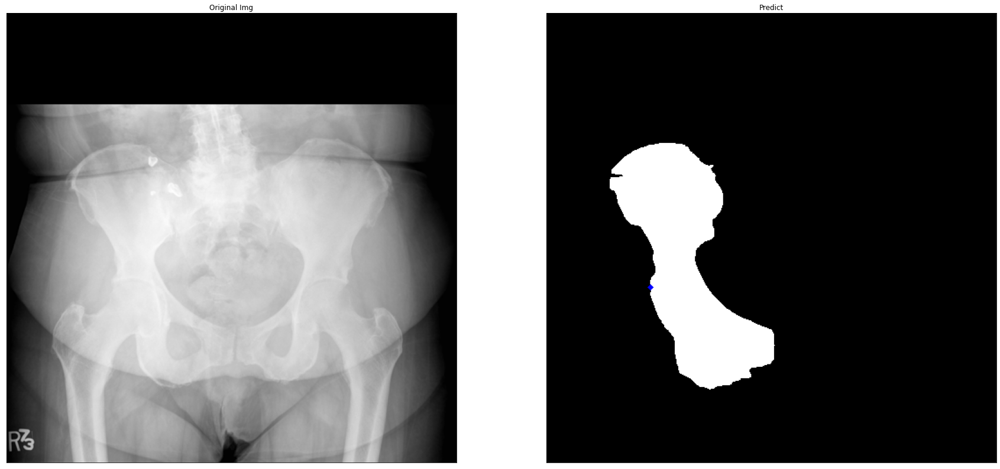

  1%|          | 1/173 [00:00<01:33,  1.84it/s]

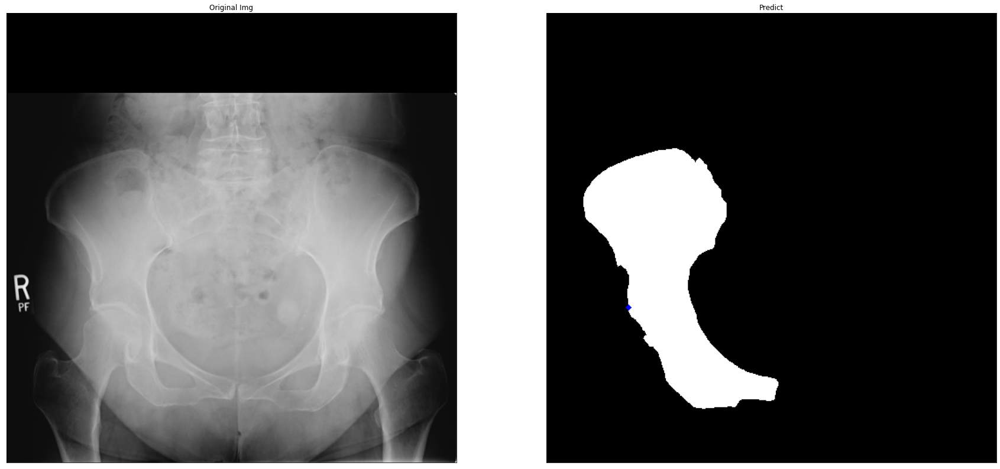

  1%|          | 2/173 [00:01<01:32,  1.85it/s]

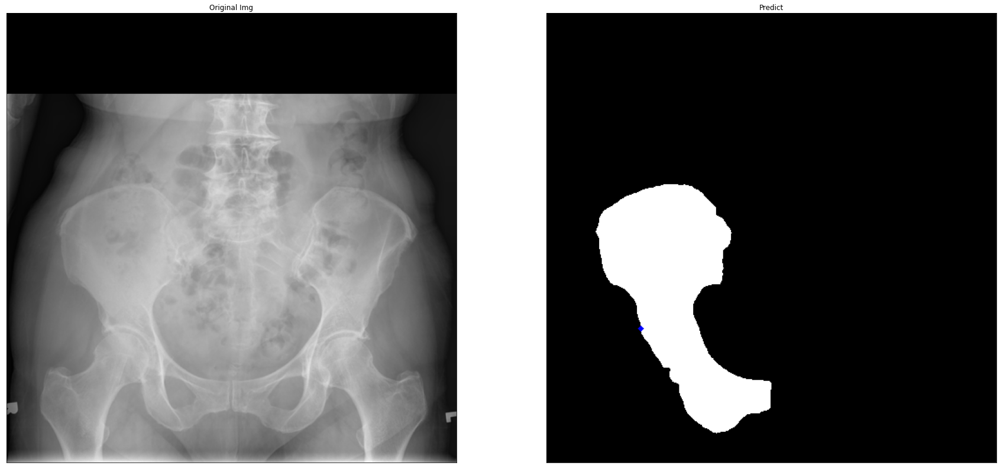

  2%|▏         | 3/173 [00:01<01:32,  1.84it/s]

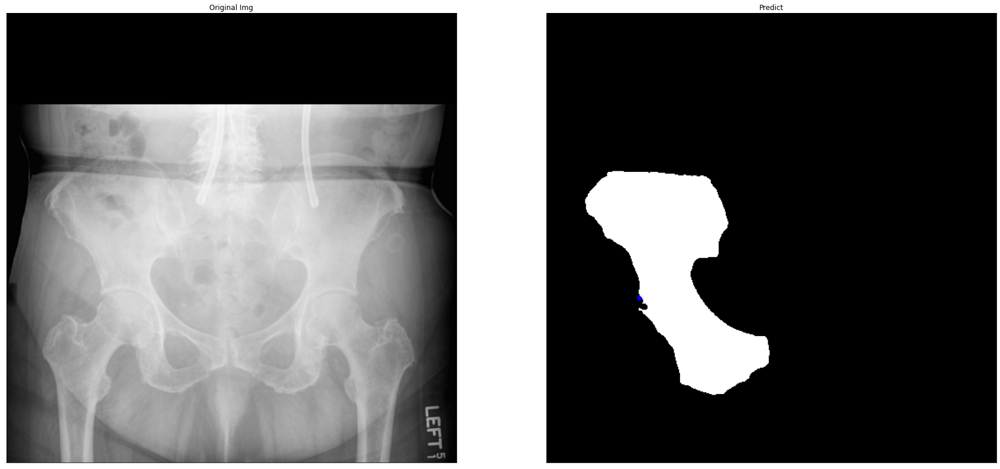

  2%|▏         | 4/173 [00:02<01:31,  1.84it/s]

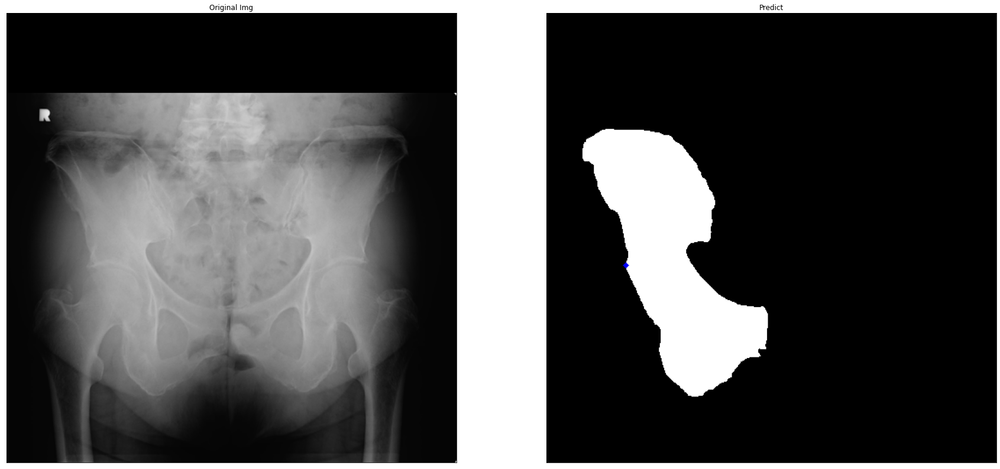

  3%|▎         | 5/173 [00:02<01:30,  1.85it/s]

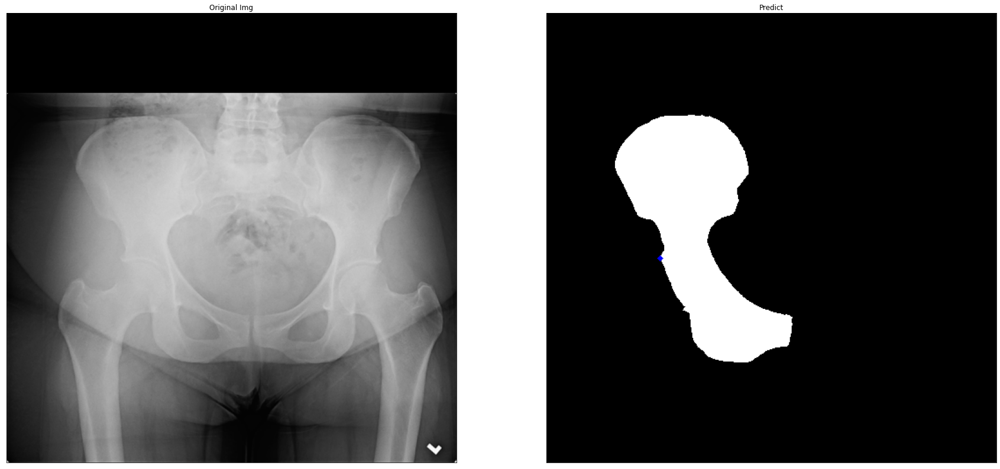

  3%|▎         | 6/173 [00:03<01:32,  1.81it/s]

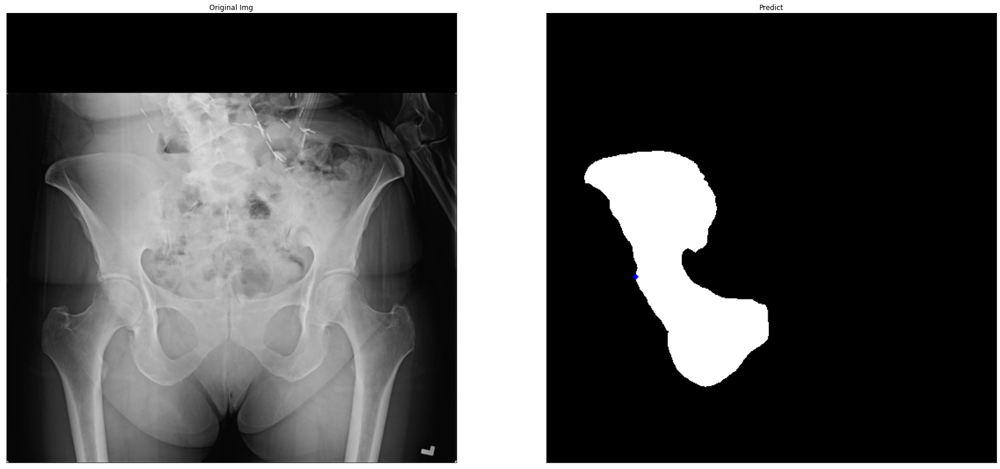

  4%|▍         | 7/173 [00:03<01:32,  1.79it/s]

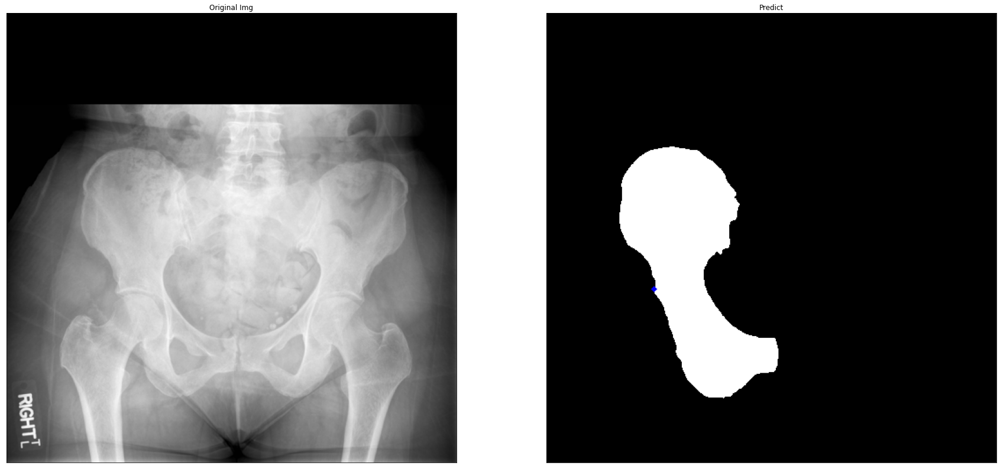

  5%|▍         | 8/173 [00:04<01:32,  1.79it/s]

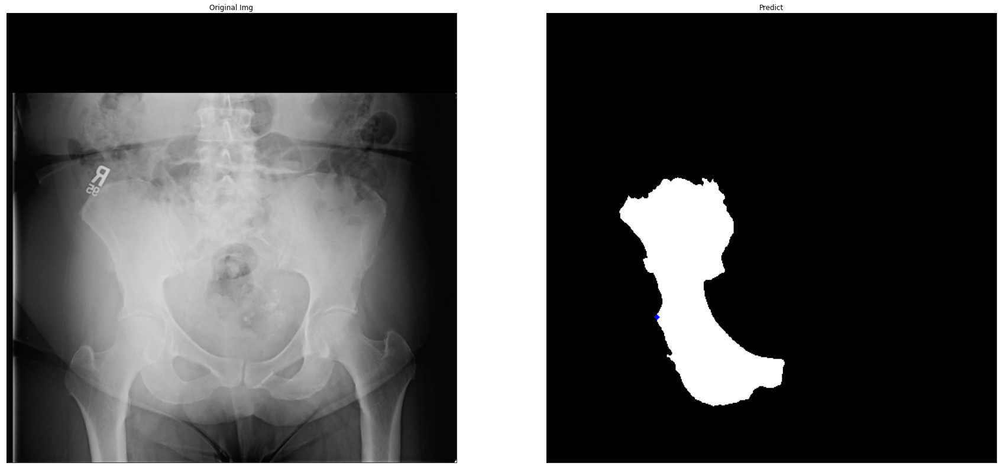

  5%|▌         | 9/173 [00:04<01:31,  1.79it/s]

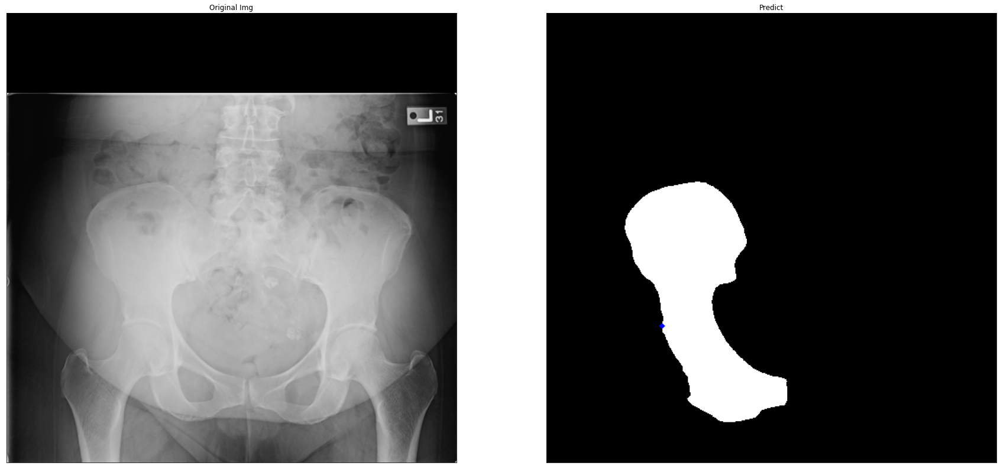

  6%|▌         | 10/173 [00:05<01:30,  1.79it/s]

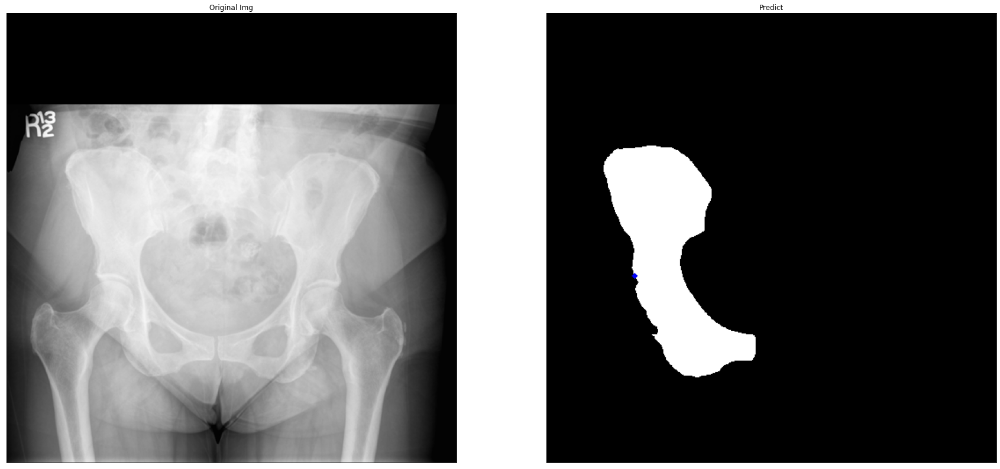

  6%|▋         | 11/173 [00:06<01:29,  1.80it/s]

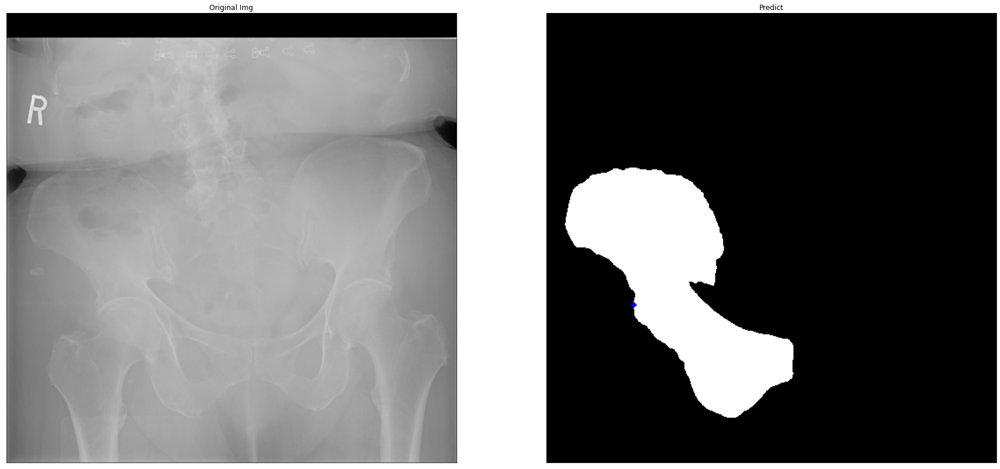

  7%|▋         | 12/173 [00:06<01:28,  1.81it/s]

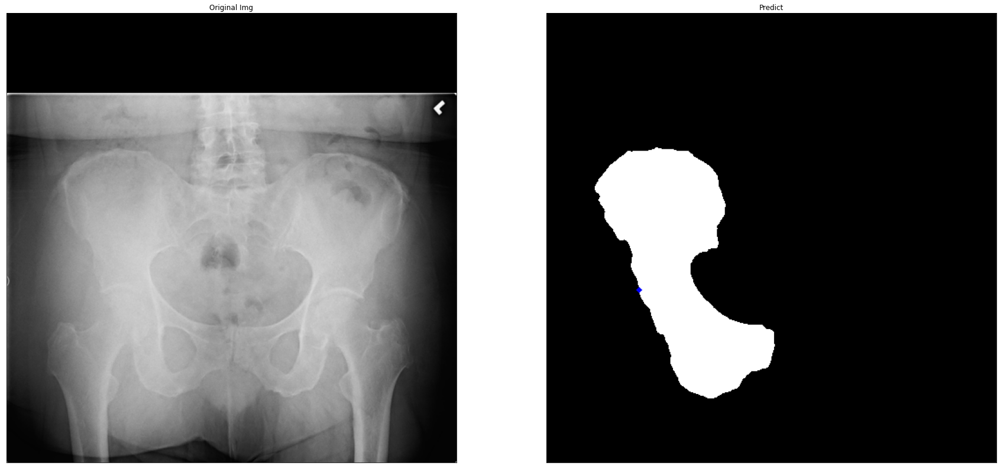

  8%|▊         | 13/173 [00:07<01:28,  1.80it/s]

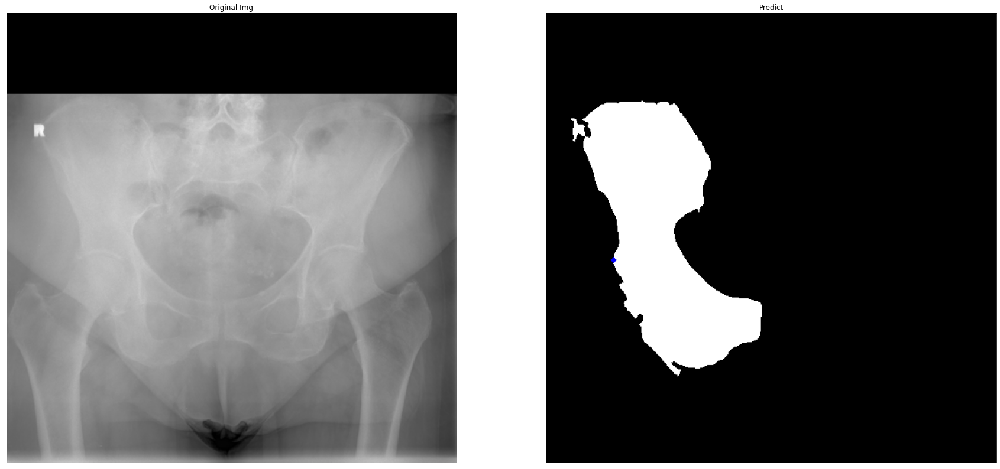

  8%|▊         | 14/173 [00:07<01:28,  1.80it/s]

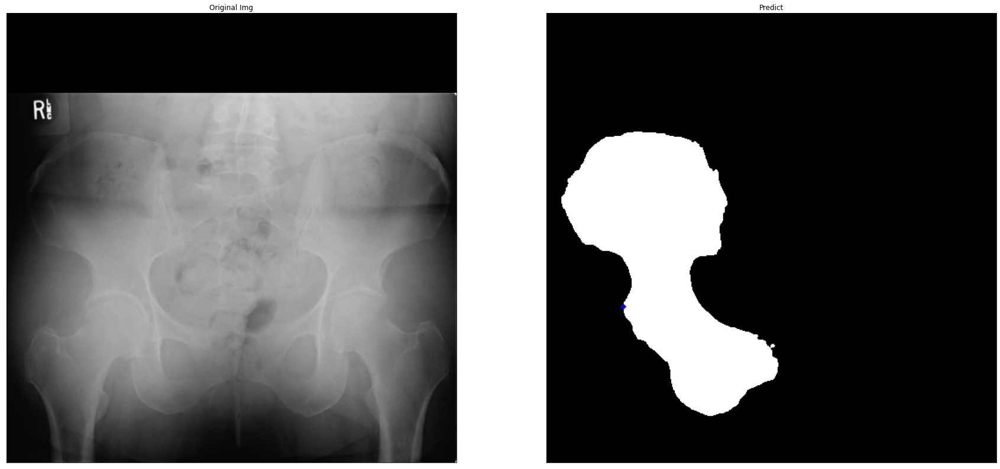

  9%|▊         | 15/173 [00:08<01:27,  1.80it/s]

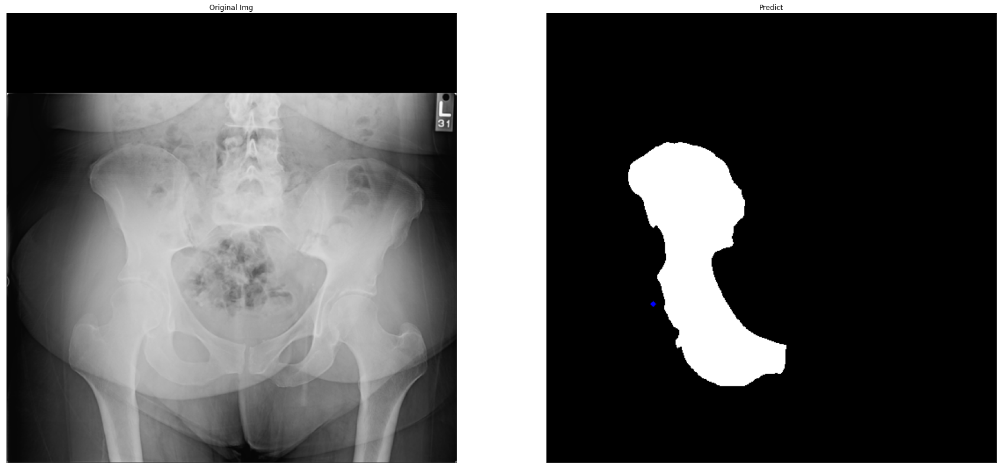

  9%|▉         | 16/173 [00:08<01:27,  1.80it/s]

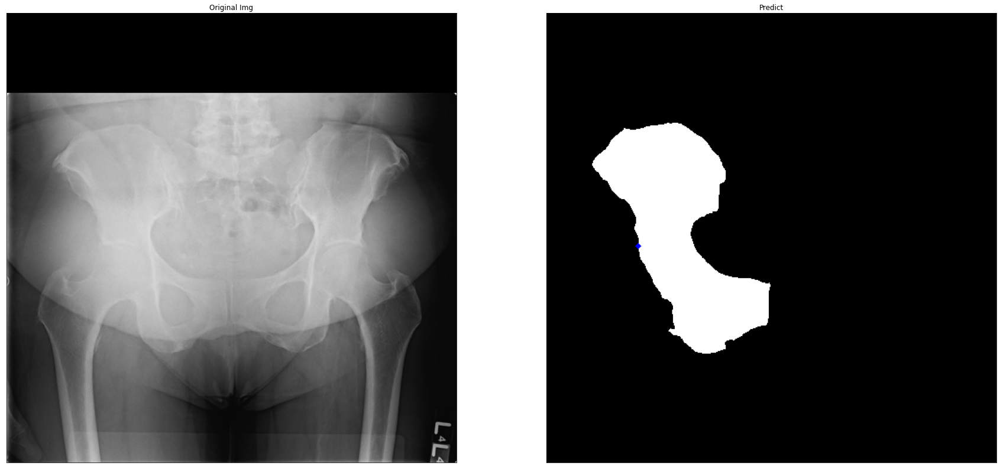

 10%|▉         | 17/173 [00:09<01:27,  1.78it/s]

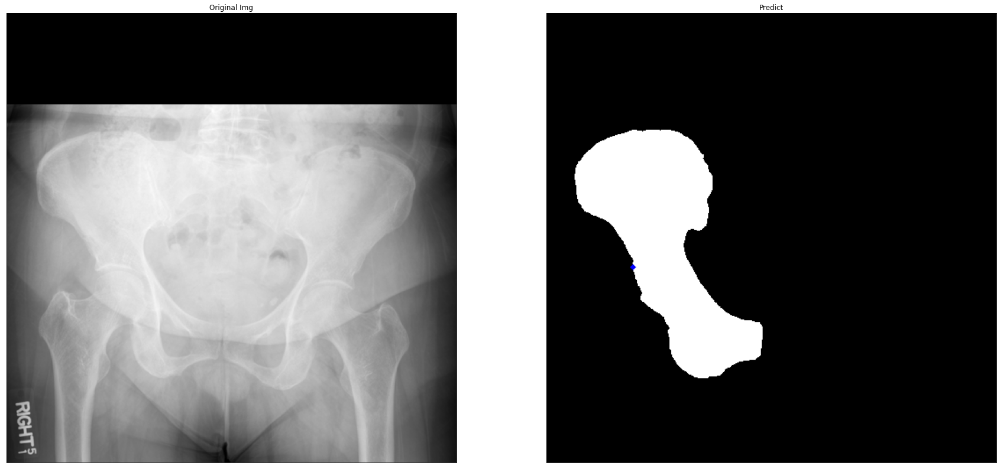

 10%|█         | 18/173 [00:09<01:26,  1.79it/s]

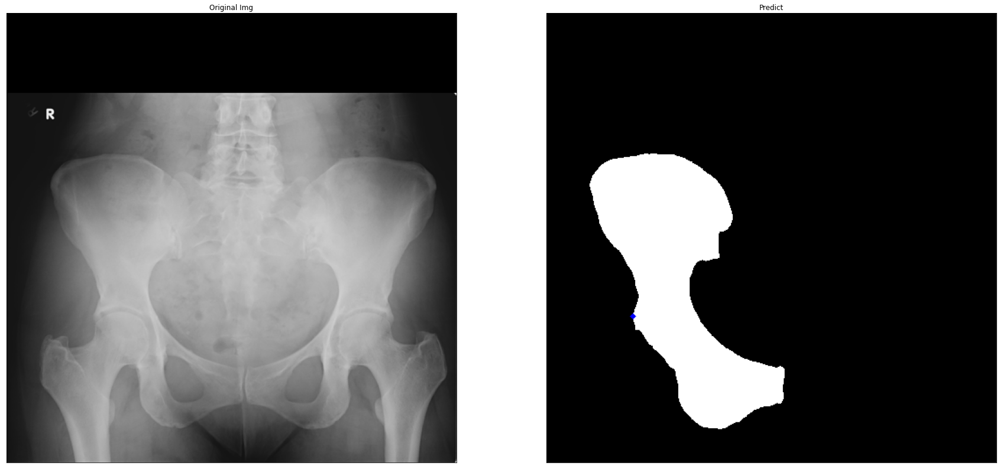

 11%|█         | 19/173 [00:10<01:25,  1.81it/s]

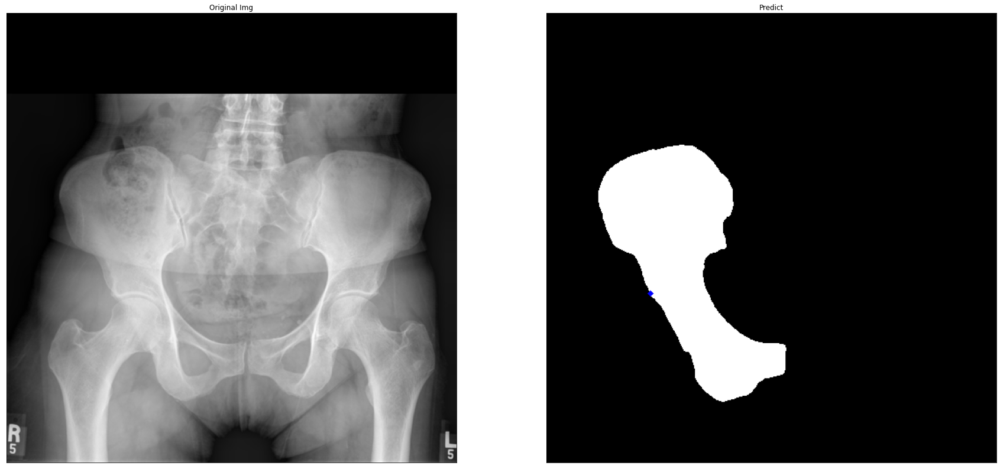

 12%|█▏        | 20/173 [00:11<01:24,  1.81it/s]

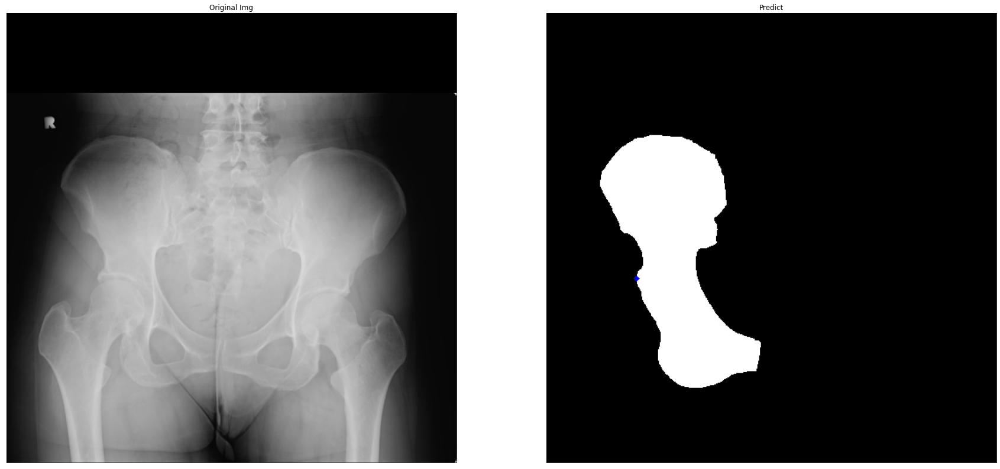

 12%|█▏        | 21/173 [00:11<01:23,  1.82it/s]

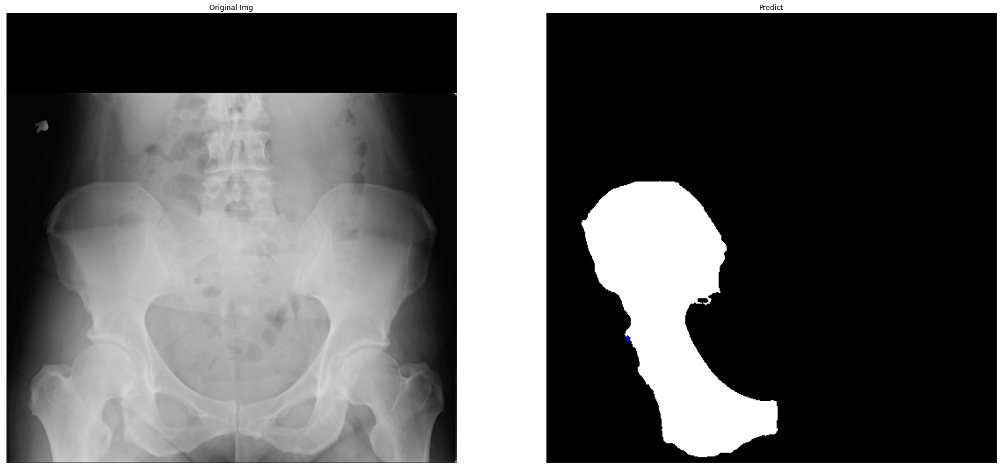

 13%|█▎        | 22/173 [00:12<01:22,  1.83it/s]

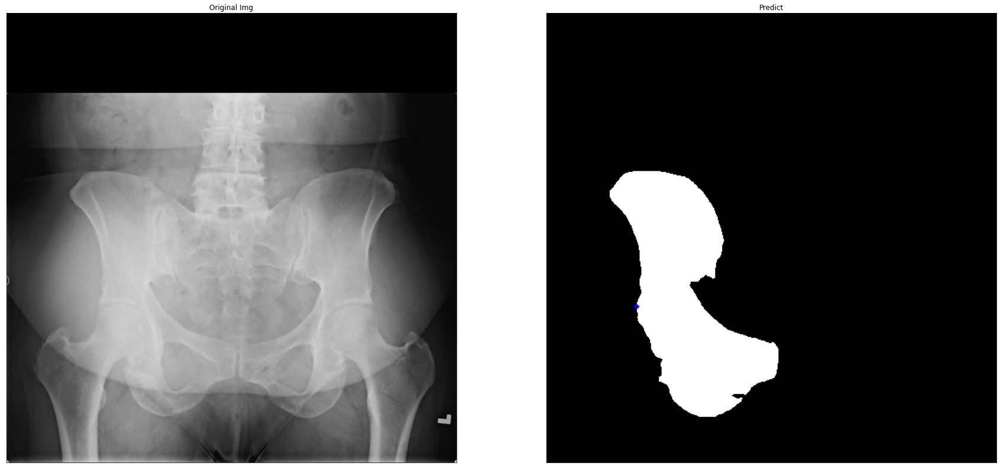

 13%|█▎        | 23/173 [00:12<01:22,  1.82it/s]

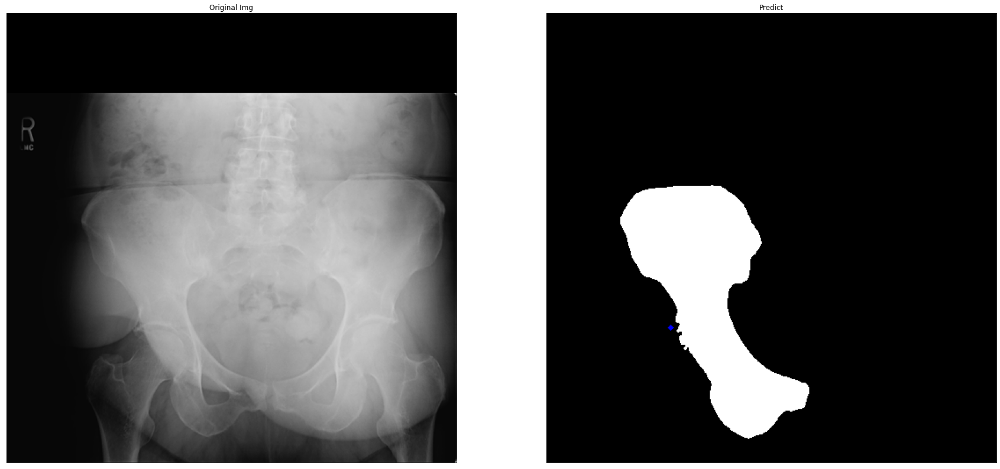

 14%|█▍        | 24/173 [00:13<01:21,  1.84it/s]

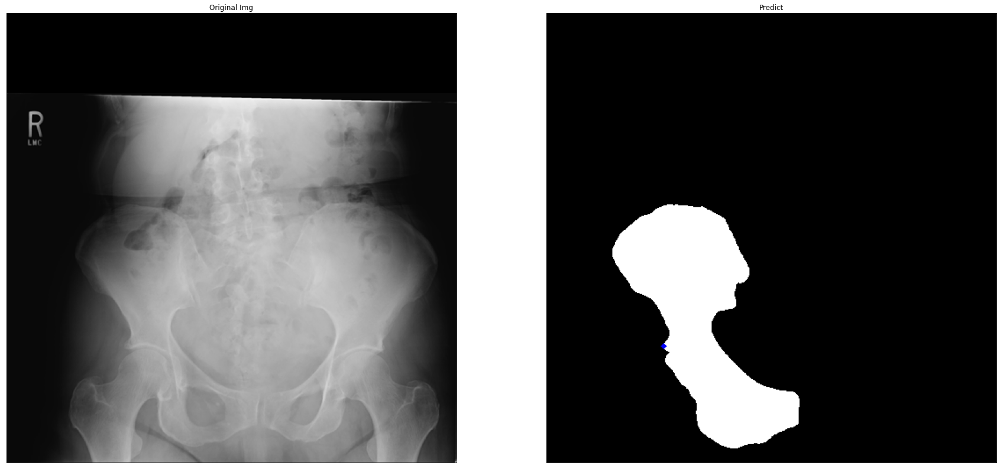

 14%|█▍        | 25/173 [00:13<01:19,  1.86it/s]

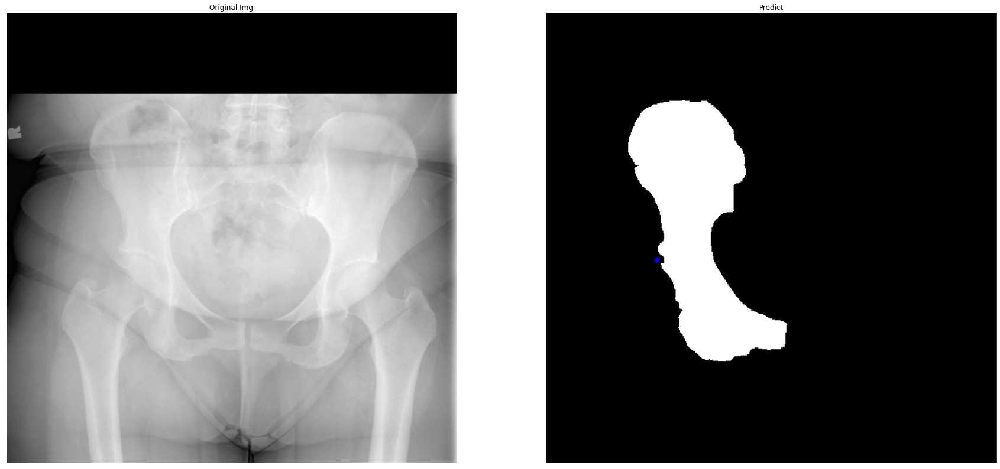

 15%|█▌        | 26/173 [00:14<01:20,  1.83it/s]

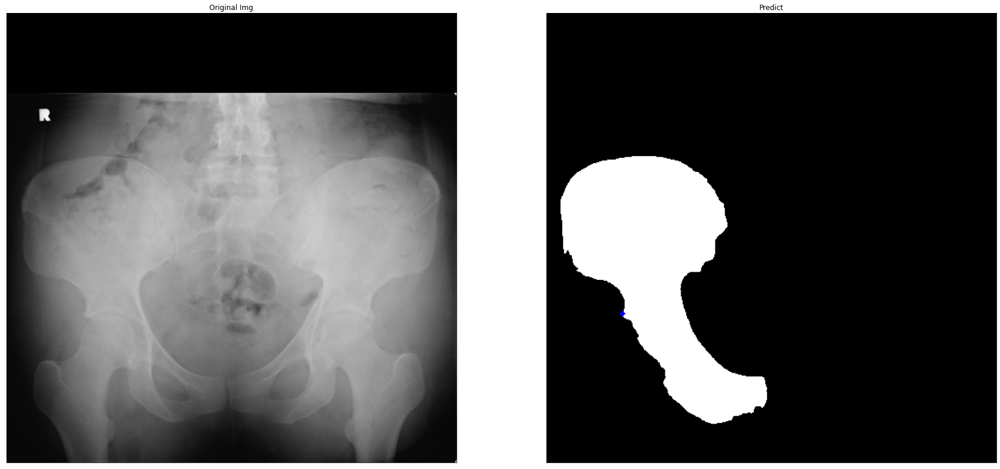

 16%|█▌        | 27/173 [00:14<01:20,  1.82it/s]

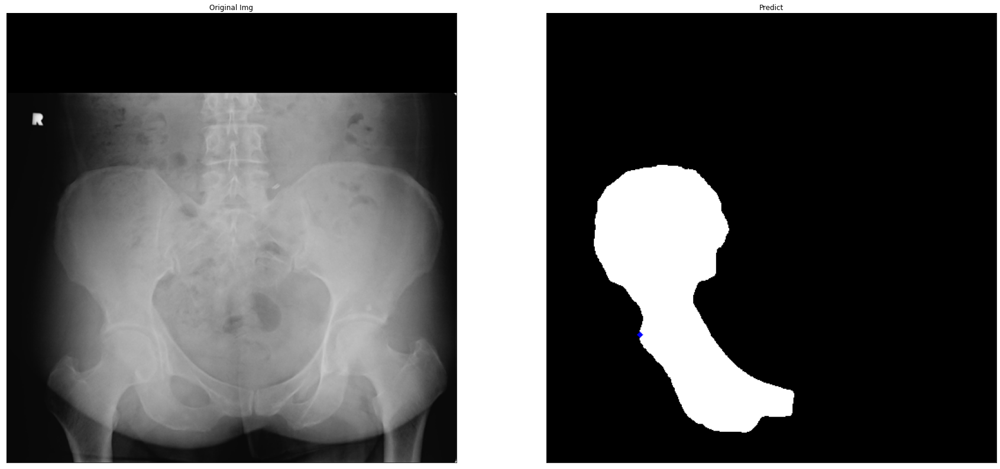

 16%|█▌        | 28/173 [00:15<01:20,  1.81it/s]

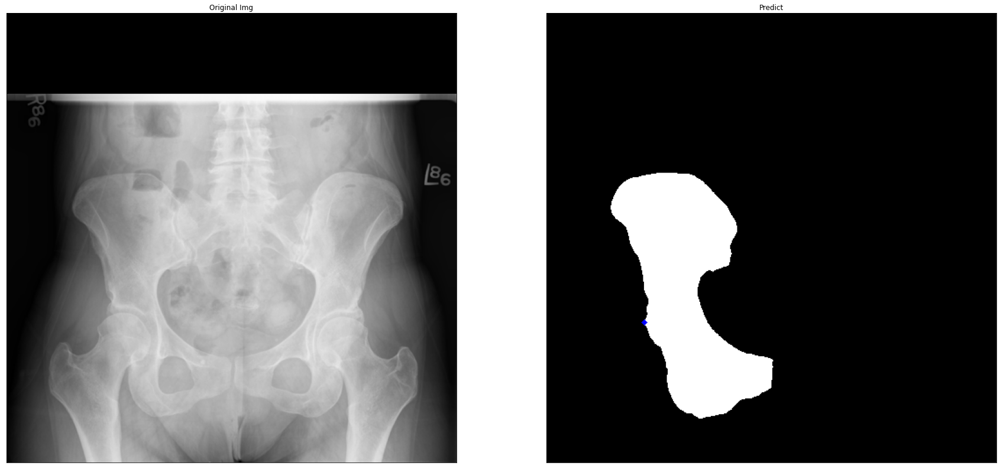

 17%|█▋        | 29/173 [00:16<01:19,  1.81it/s]

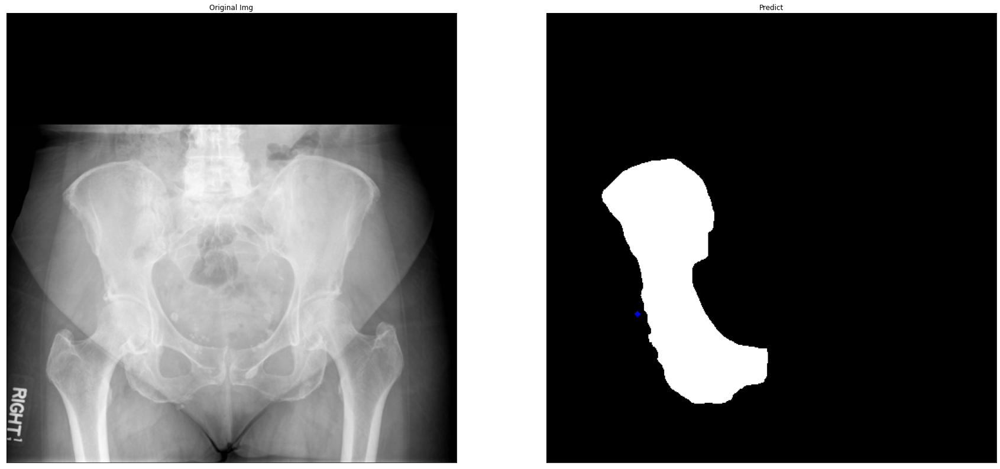

 17%|█▋        | 30/173 [00:16<01:18,  1.82it/s]

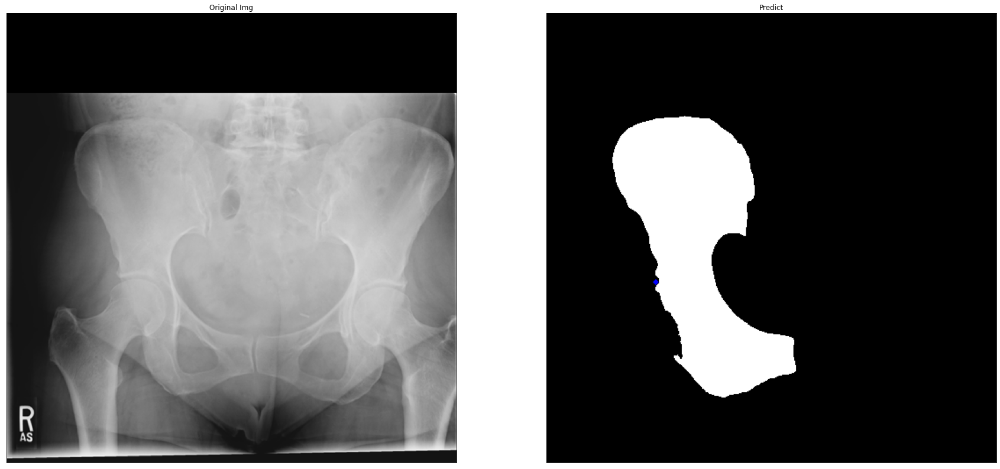

 18%|█▊        | 31/173 [00:17<01:17,  1.82it/s]

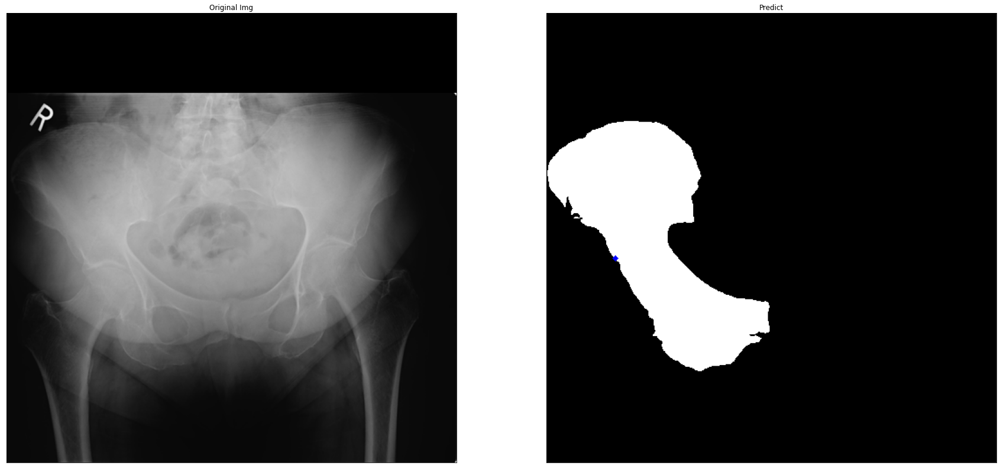

 18%|█▊        | 32/173 [00:17<01:16,  1.84it/s]

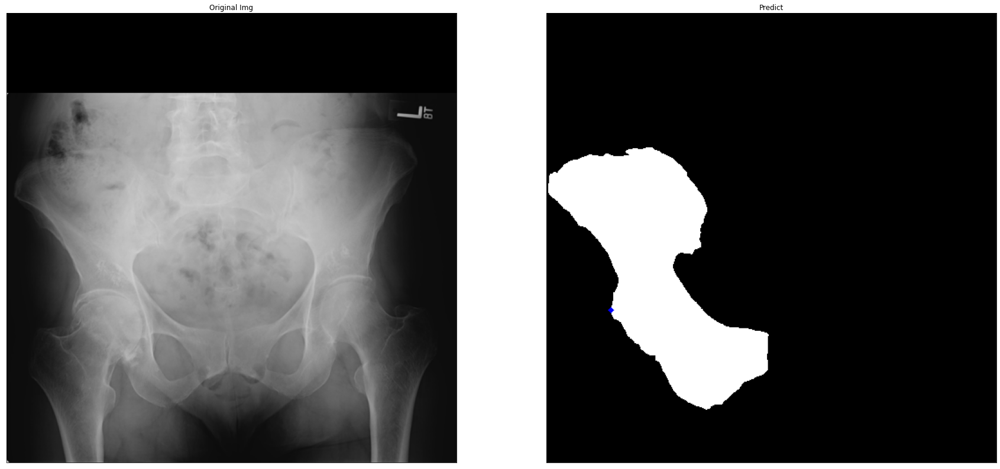

 19%|█▉        | 33/173 [00:18<01:15,  1.84it/s]

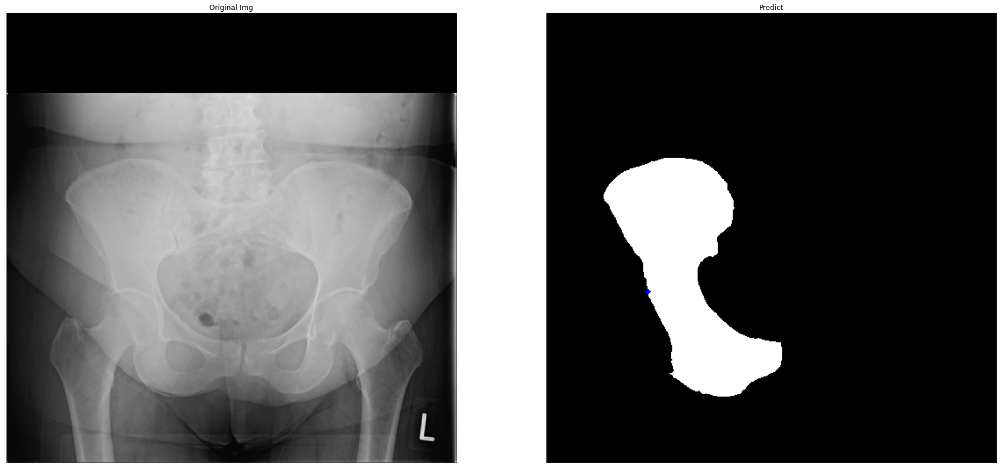

 20%|█▉        | 34/173 [00:18<01:15,  1.83it/s]

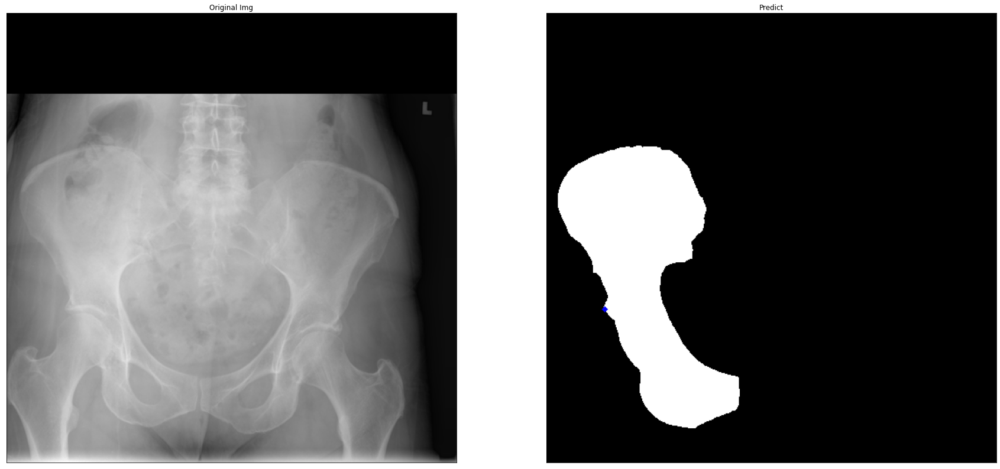

 20%|██        | 35/173 [00:19<01:38,  1.40it/s]

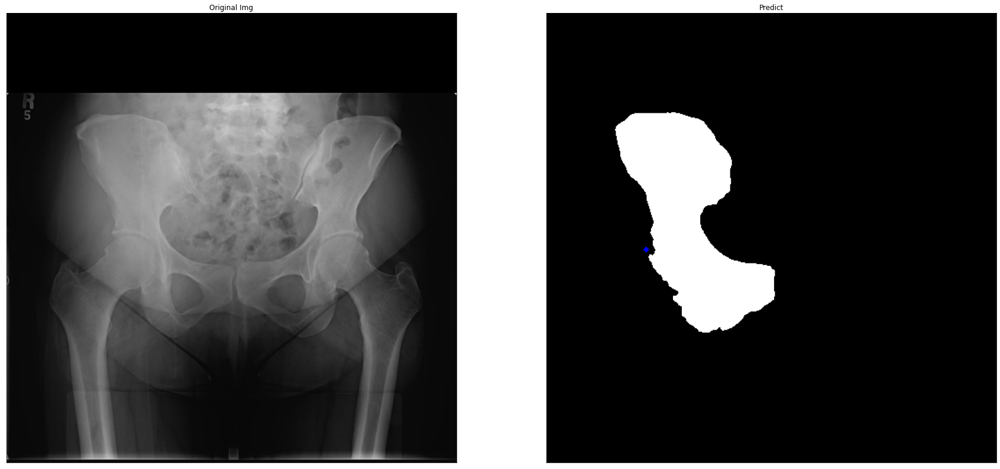

 21%|██        | 36/173 [00:20<01:30,  1.51it/s]

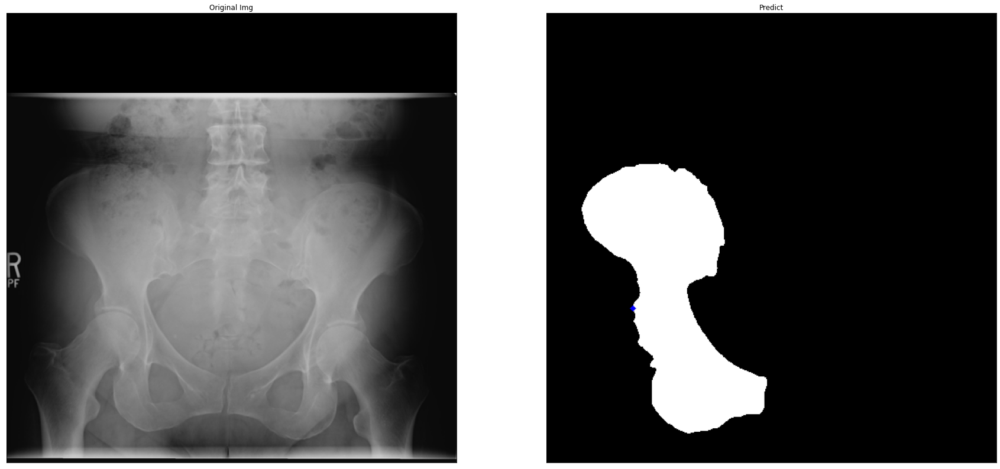

 21%|██▏       | 37/173 [00:20<01:24,  1.61it/s]

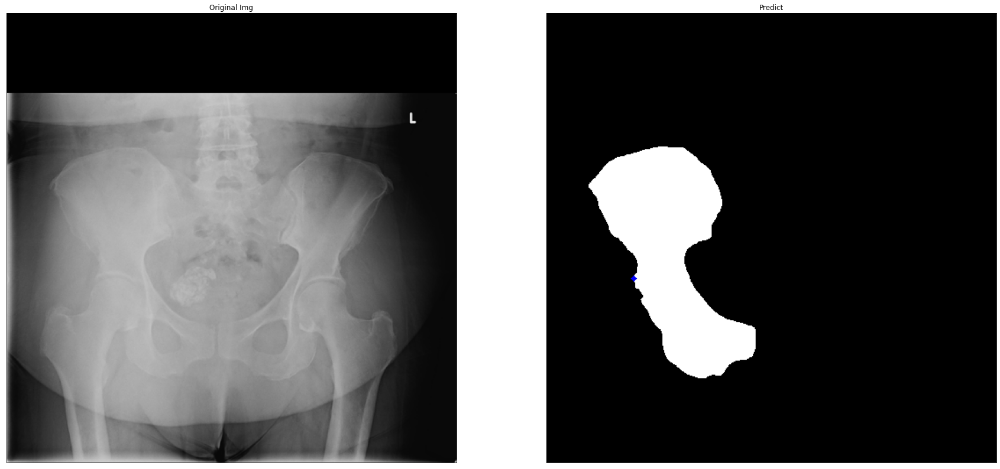

 22%|██▏       | 38/173 [00:21<01:21,  1.67it/s]

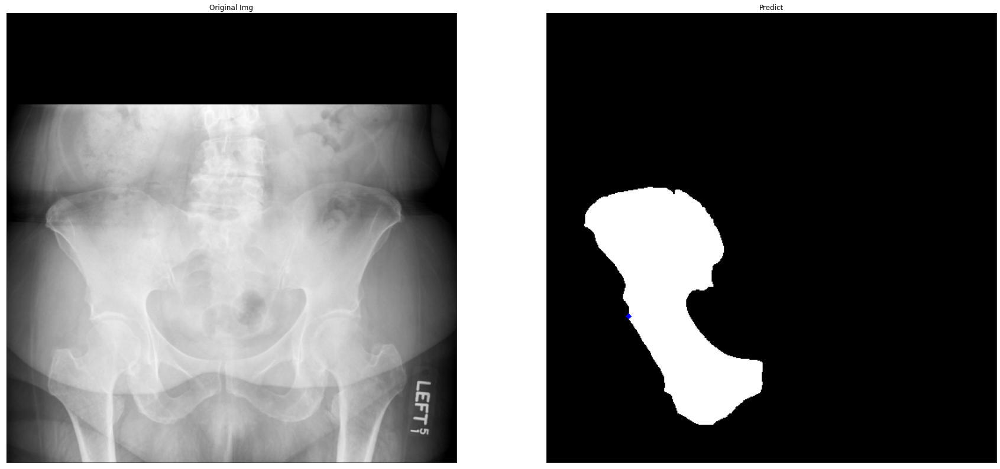

 23%|██▎       | 39/173 [00:21<01:18,  1.70it/s]

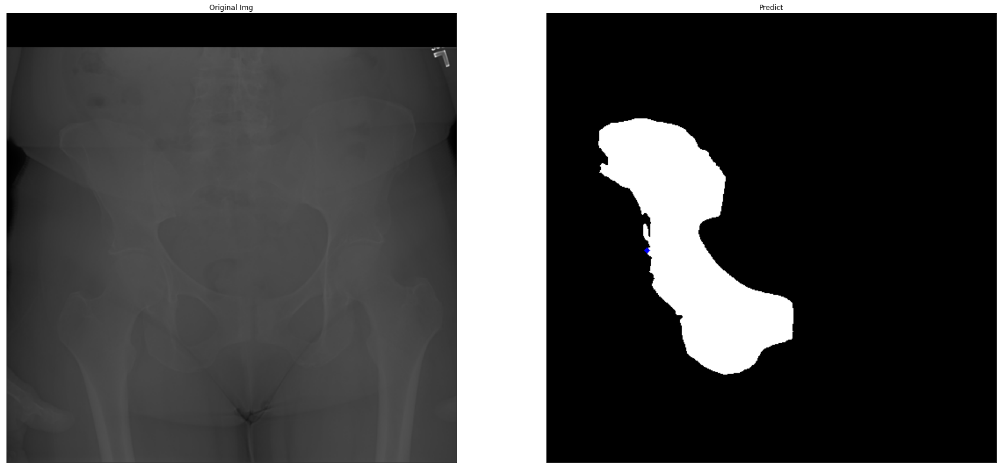

 23%|██▎       | 40/173 [00:22<01:14,  1.79it/s]

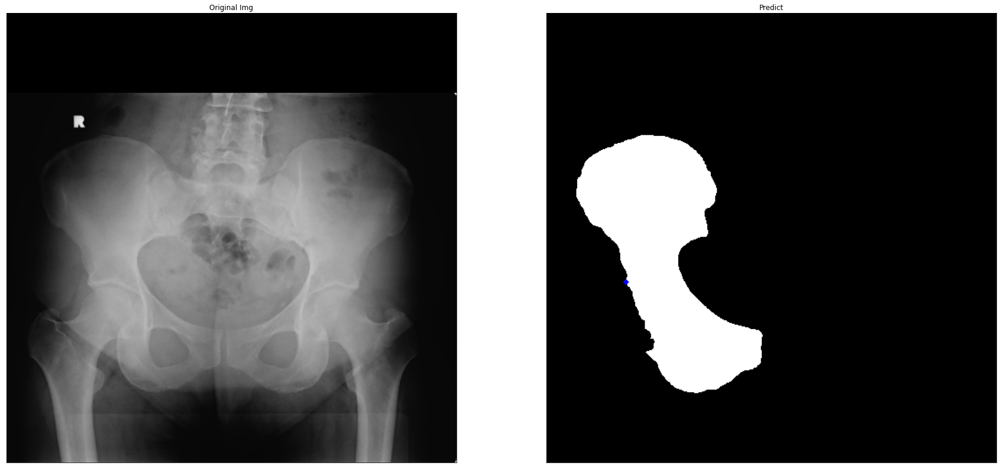

 24%|██▎       | 41/173 [00:23<01:12,  1.81it/s]

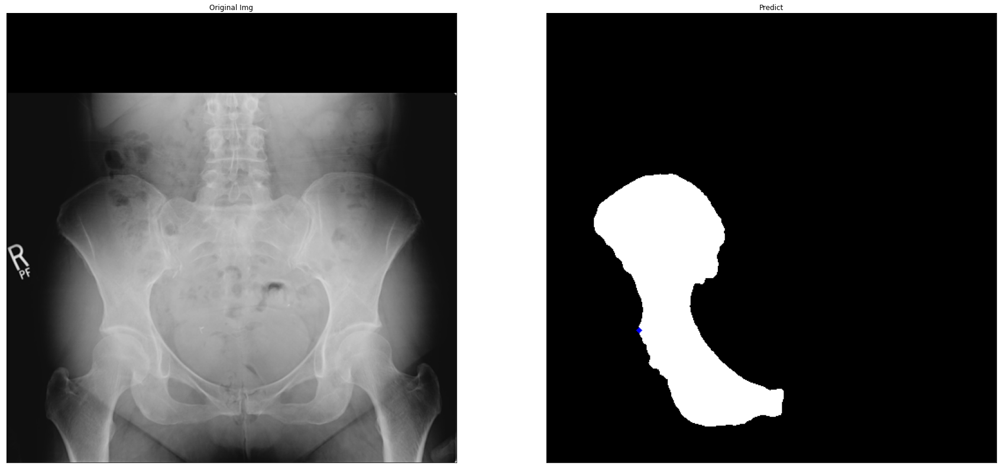

 24%|██▍       | 42/173 [00:23<01:12,  1.81it/s]

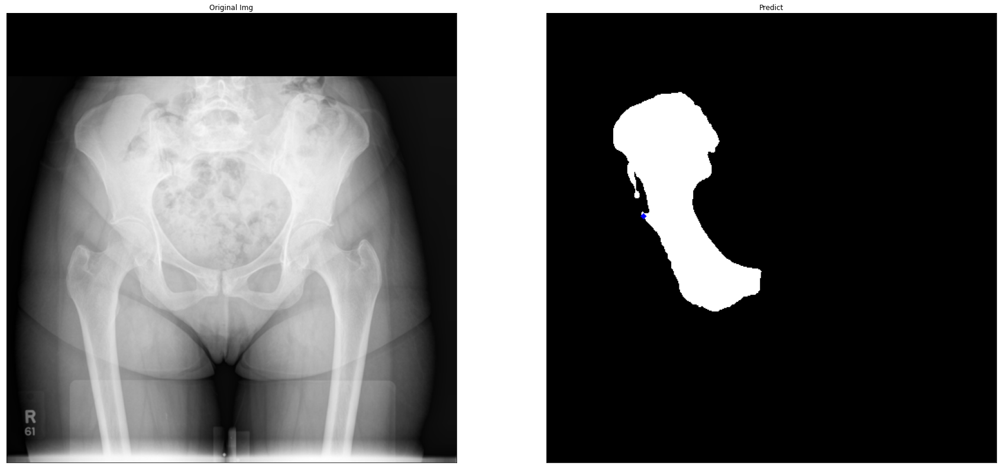

 25%|██▍       | 43/173 [00:24<01:11,  1.82it/s]

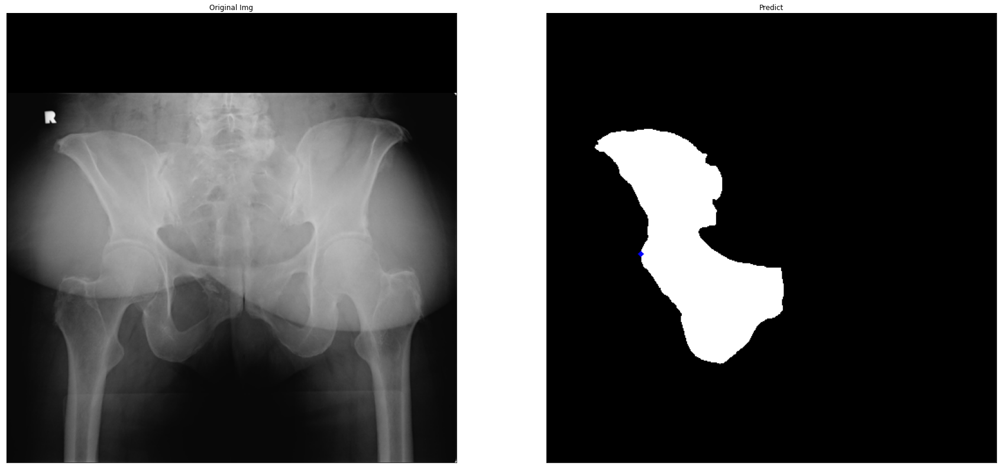

 25%|██▌       | 44/173 [00:24<01:10,  1.83it/s]

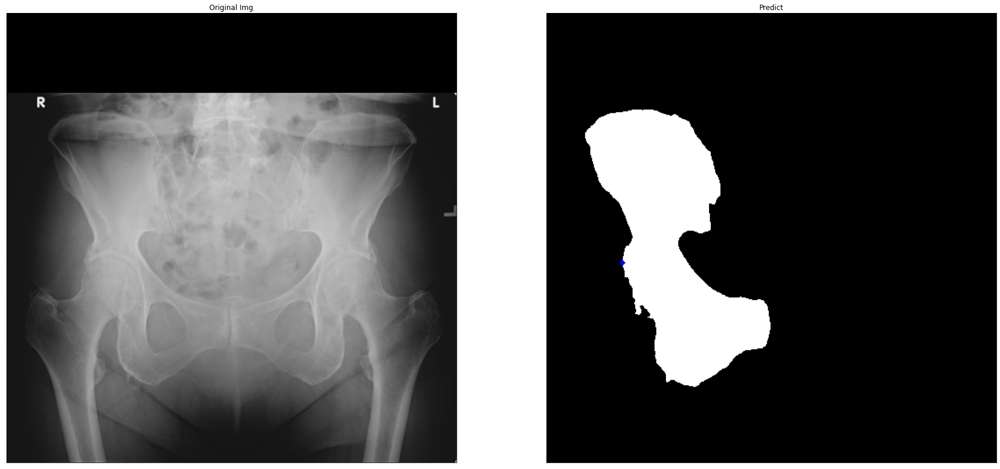

 26%|██▌       | 45/173 [00:25<01:10,  1.83it/s]

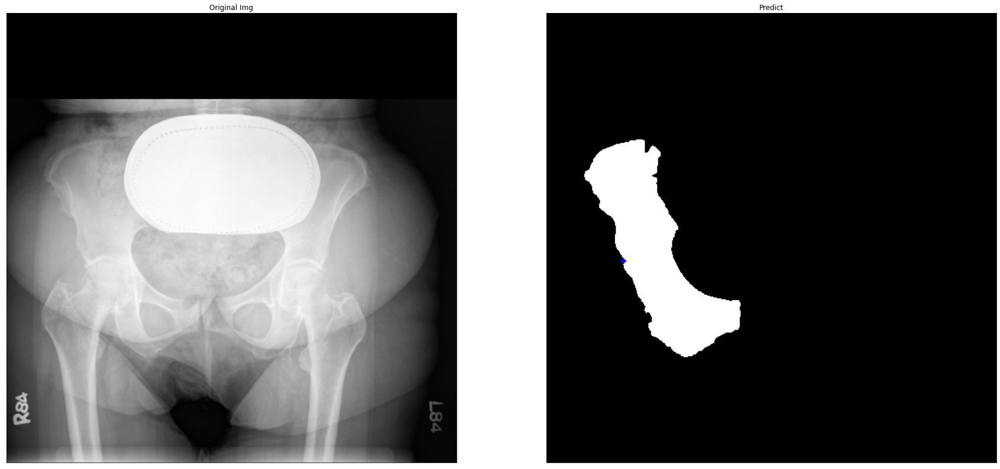

 27%|██▋       | 46/173 [00:25<01:09,  1.83it/s]

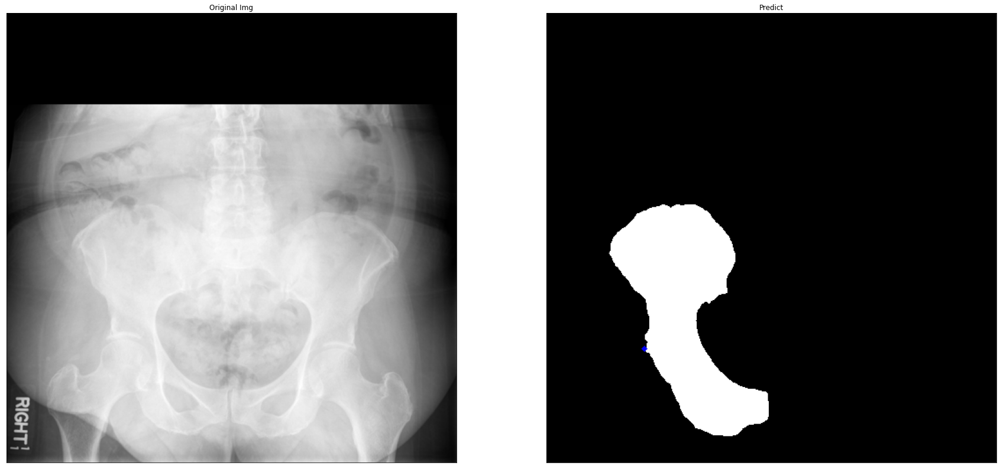

 27%|██▋       | 47/173 [00:26<01:08,  1.83it/s]

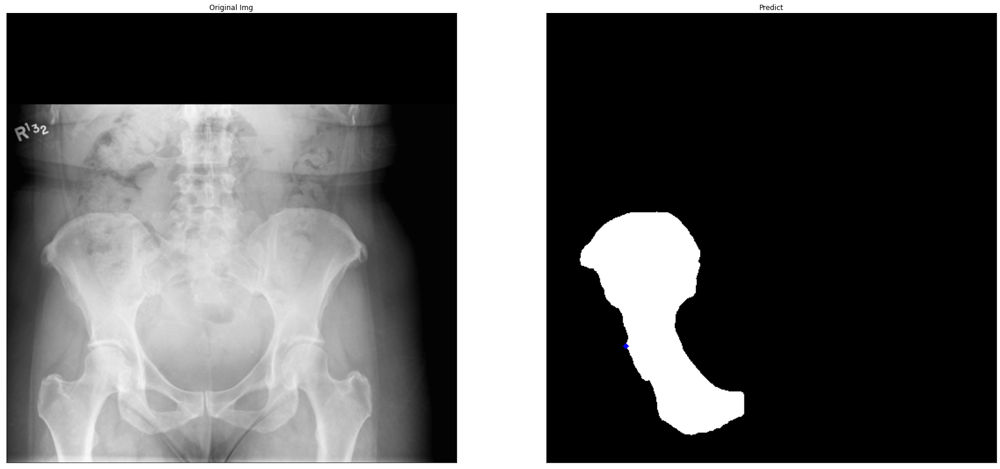

 28%|██▊       | 48/173 [00:26<01:08,  1.84it/s]

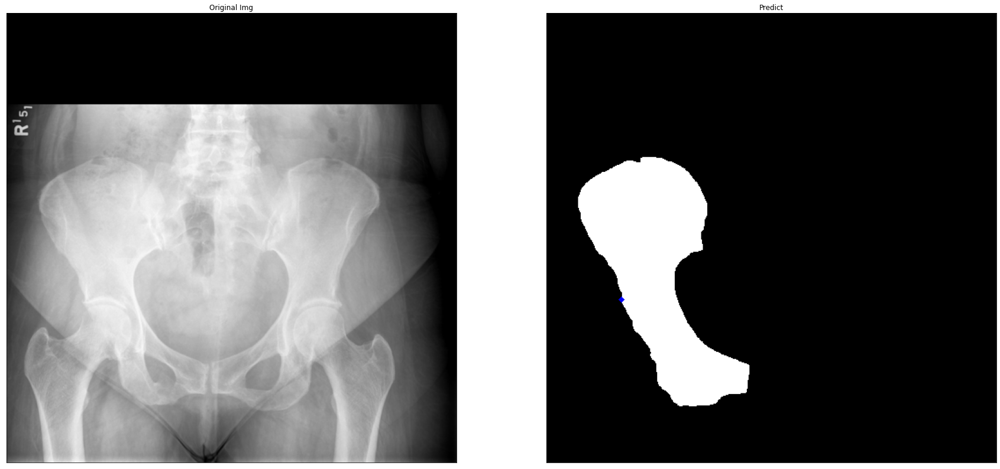

 28%|██▊       | 49/173 [00:27<01:07,  1.83it/s]

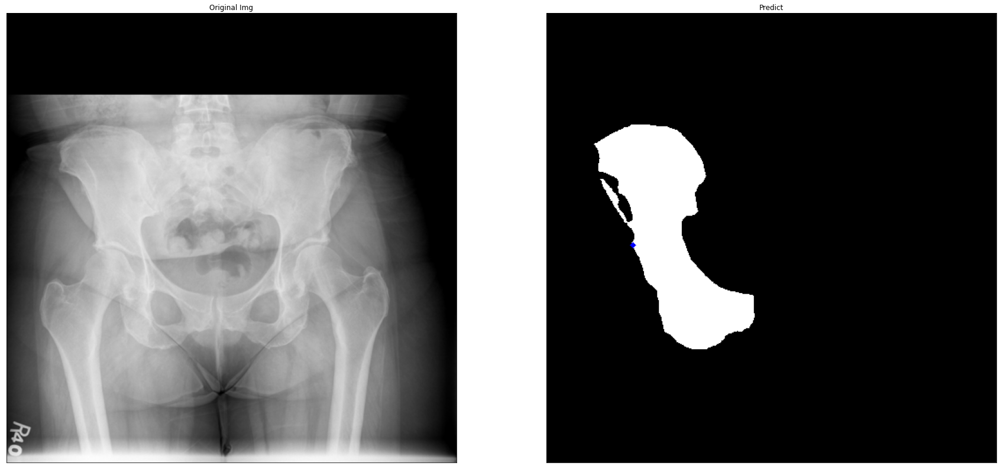

 29%|██▉       | 50/173 [00:27<01:07,  1.81it/s]

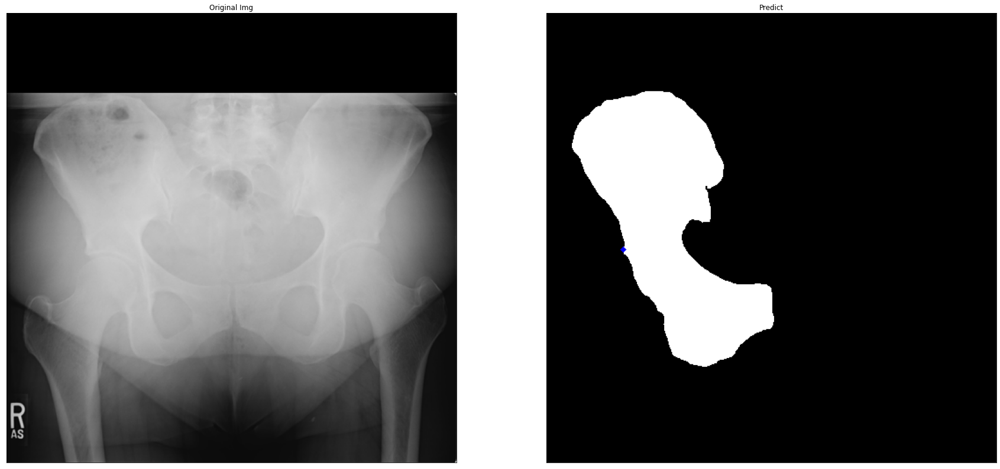

 29%|██▉       | 51/173 [00:28<01:07,  1.82it/s]

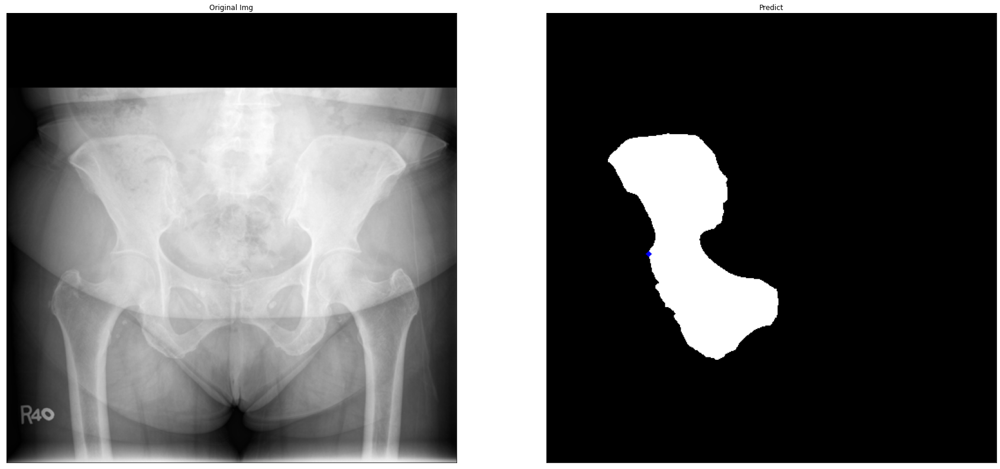

 30%|███       | 52/173 [00:29<01:06,  1.81it/s]

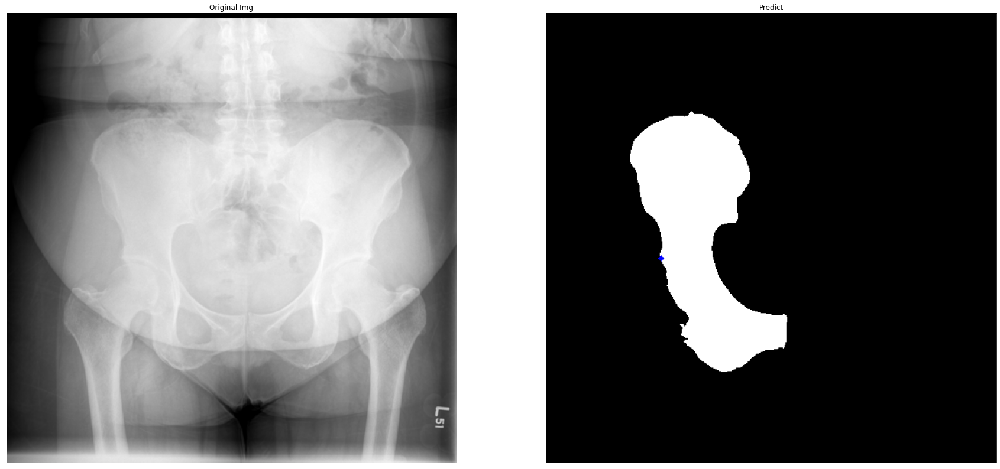

 31%|███       | 53/173 [00:29<01:07,  1.78it/s]

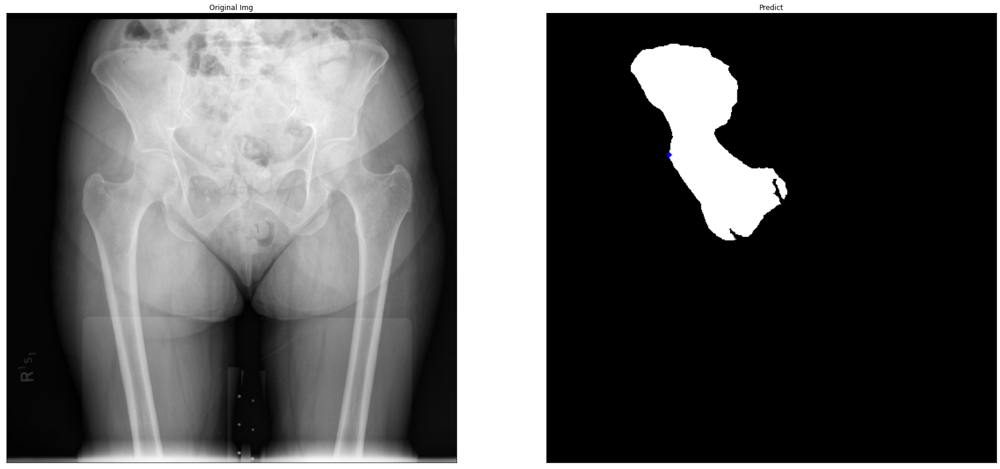

 31%|███       | 54/173 [00:30<01:06,  1.78it/s]

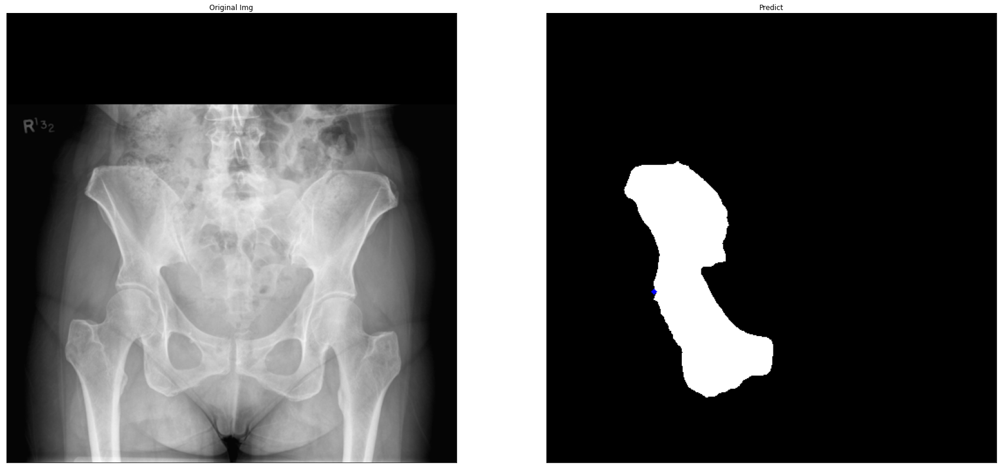

 32%|███▏      | 55/173 [00:30<01:05,  1.79it/s]

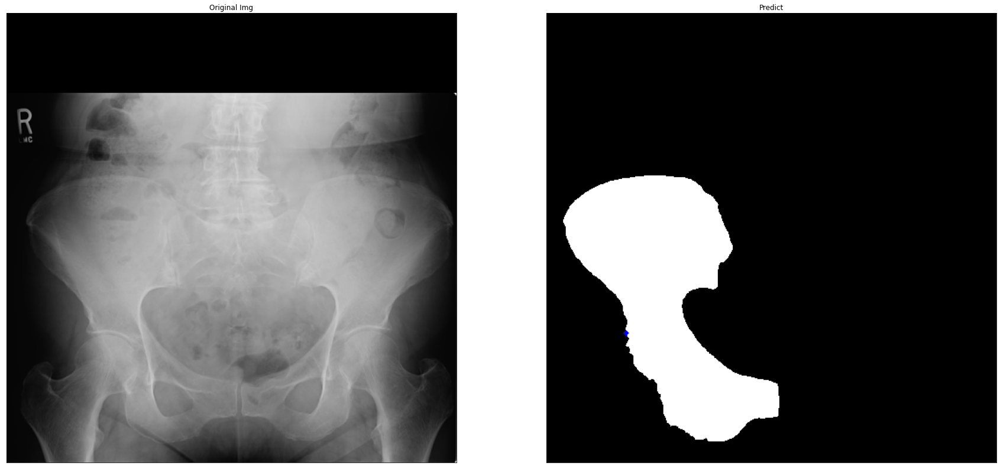

 32%|███▏      | 56/173 [00:31<01:05,  1.79it/s]

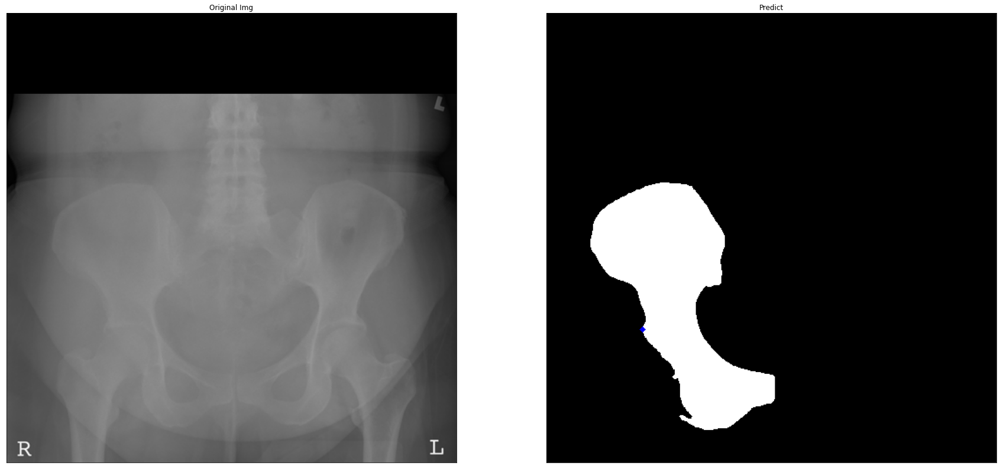

 33%|███▎      | 57/173 [00:31<01:03,  1.82it/s]

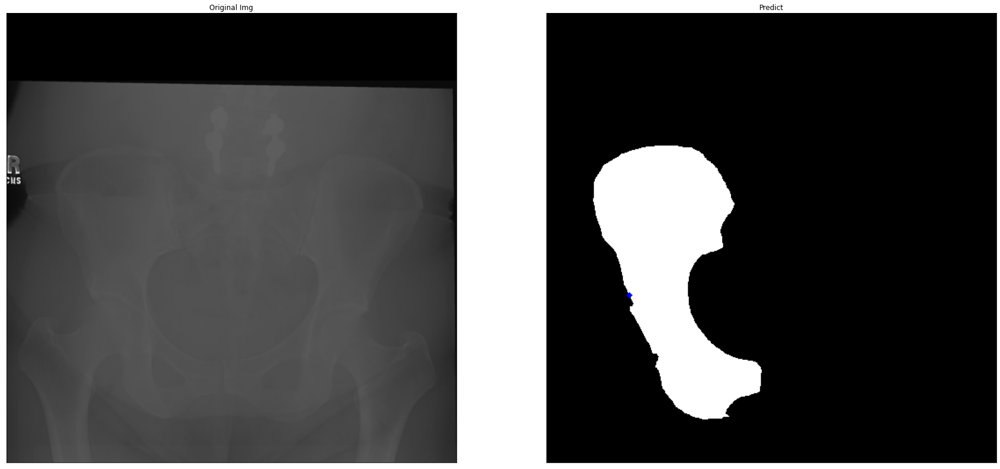

 34%|███▎      | 58/173 [00:32<01:00,  1.89it/s]

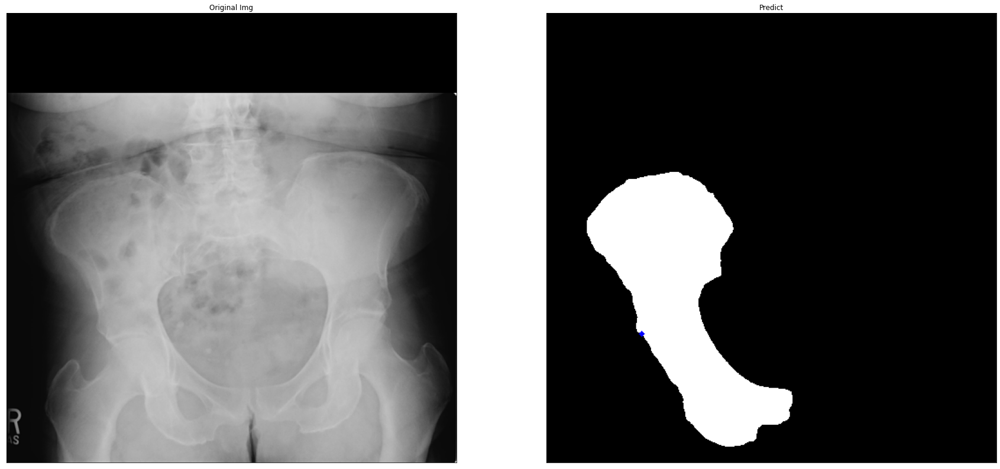

 34%|███▍      | 59/173 [00:32<01:00,  1.87it/s]

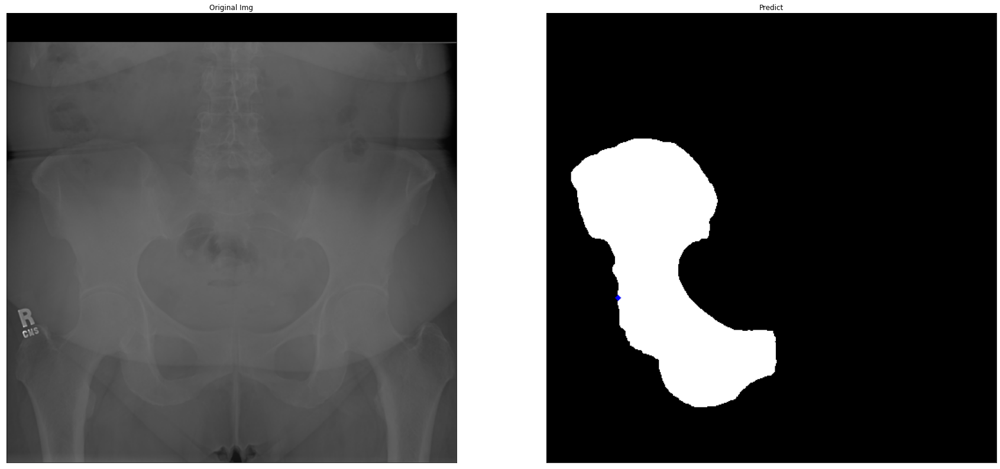

 35%|███▍      | 60/173 [00:33<00:59,  1.89it/s]

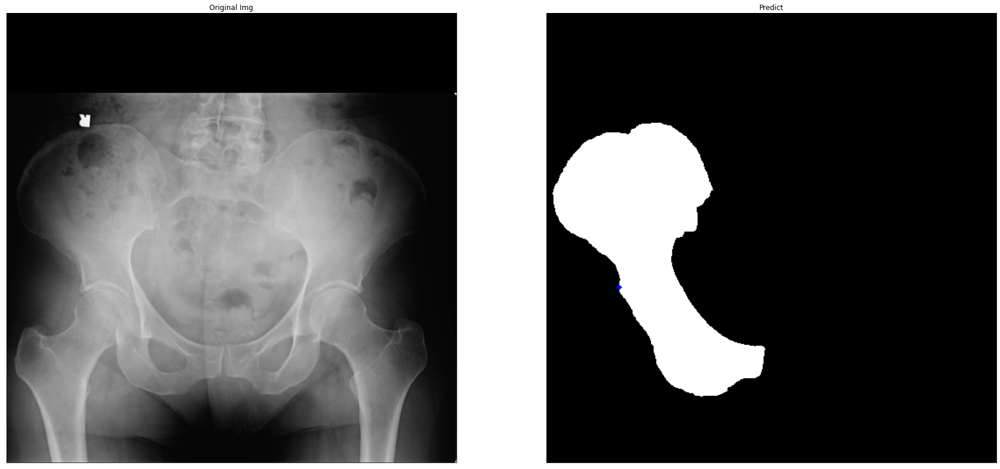

 35%|███▌      | 61/173 [00:33<00:59,  1.88it/s]

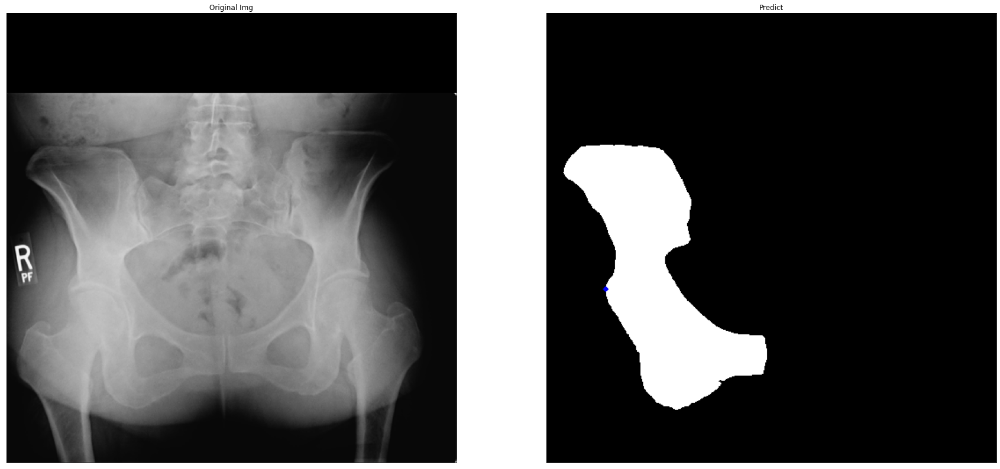

 36%|███▌      | 62/173 [00:34<00:59,  1.87it/s]

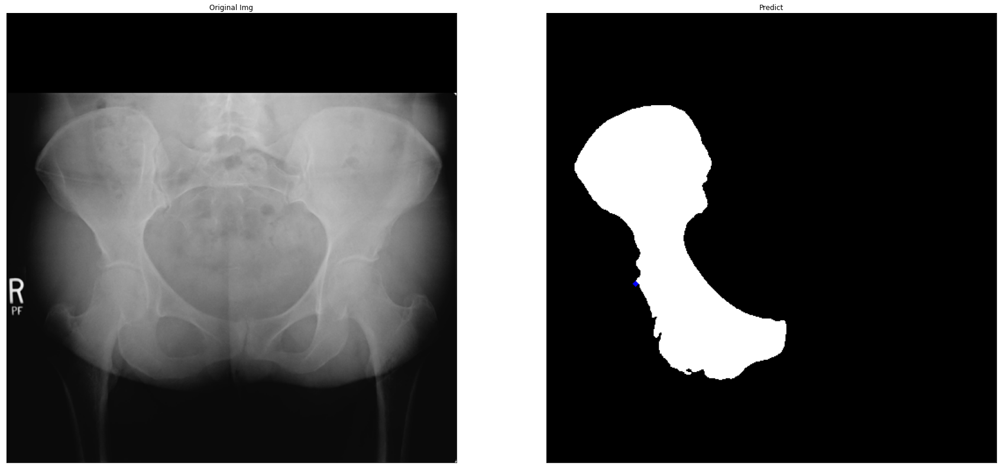

 36%|███▋      | 63/173 [00:34<00:58,  1.87it/s]

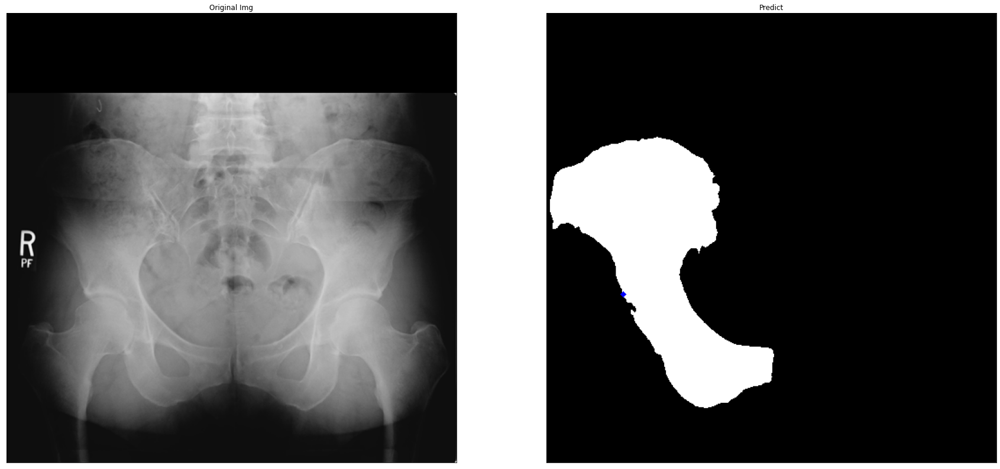

 37%|███▋      | 64/173 [00:35<00:59,  1.85it/s]

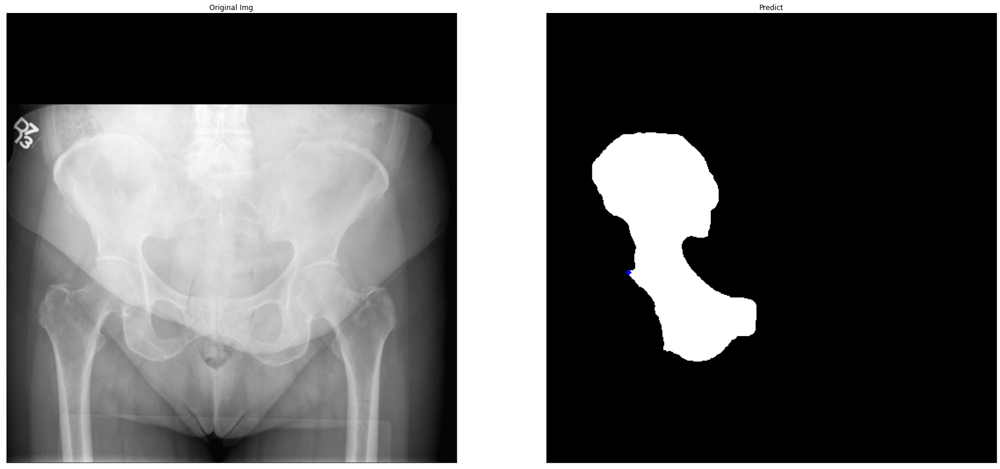

 38%|███▊      | 65/173 [00:36<00:59,  1.82it/s]

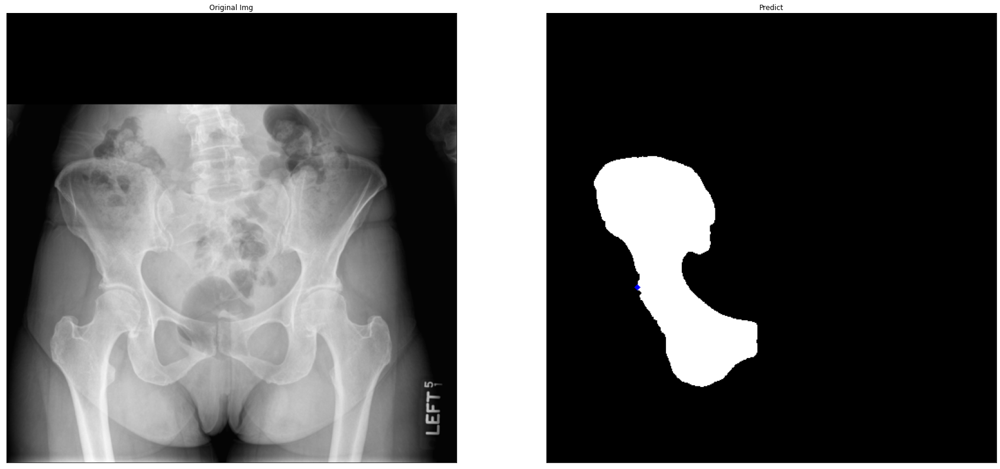

 38%|███▊      | 66/173 [00:36<00:58,  1.82it/s]

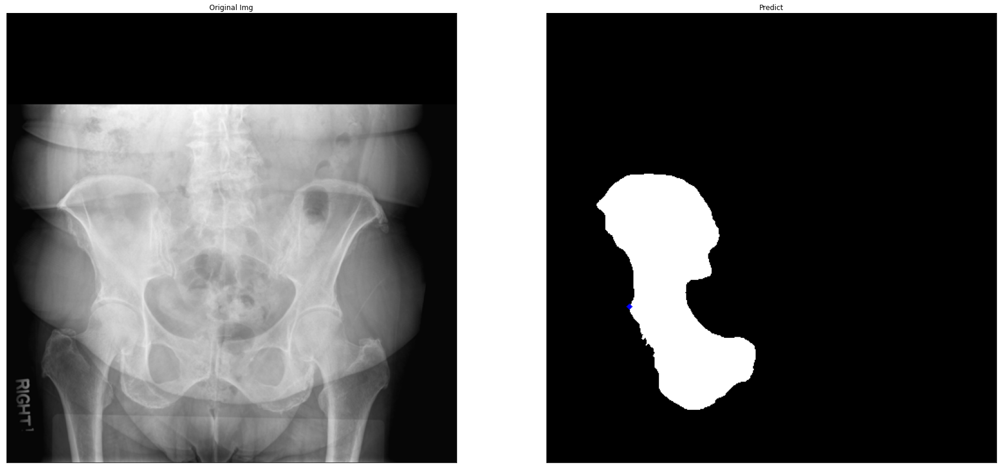

 39%|███▊      | 67/173 [00:37<00:58,  1.83it/s]

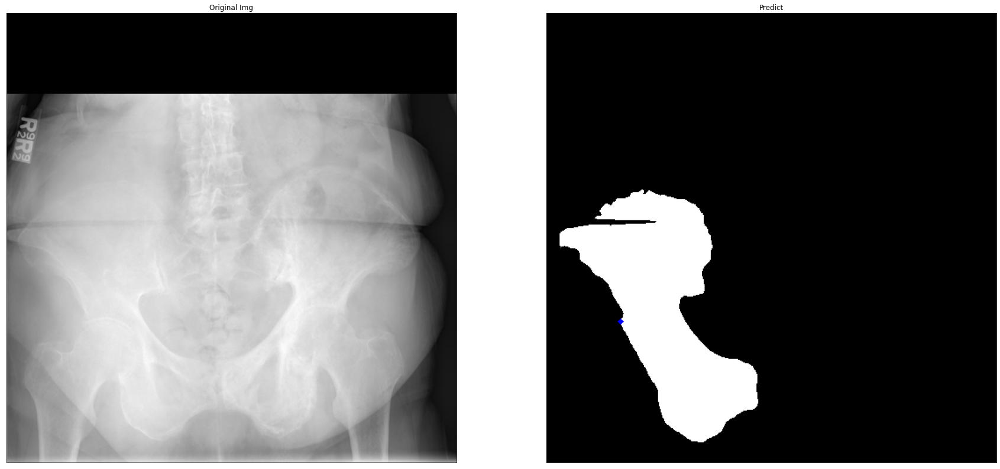

 39%|███▉      | 68/173 [00:37<00:57,  1.82it/s]

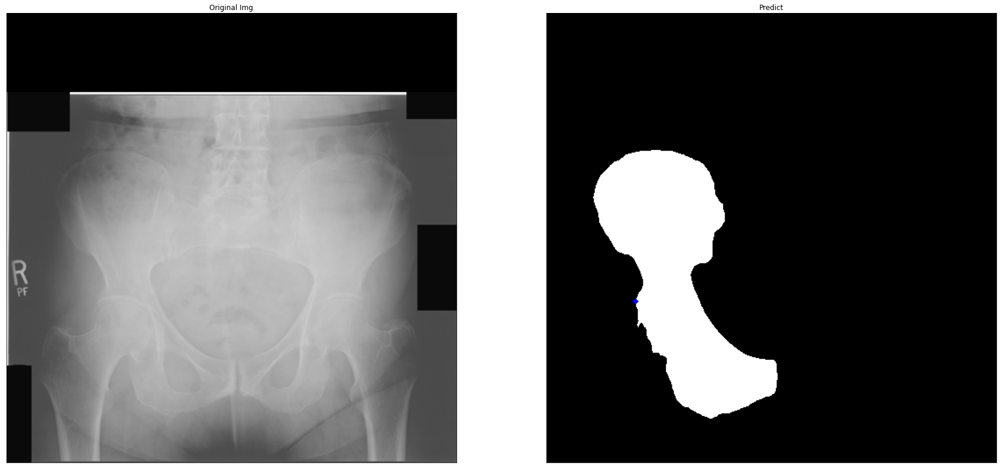

 40%|███▉      | 69/173 [00:38<00:56,  1.85it/s]

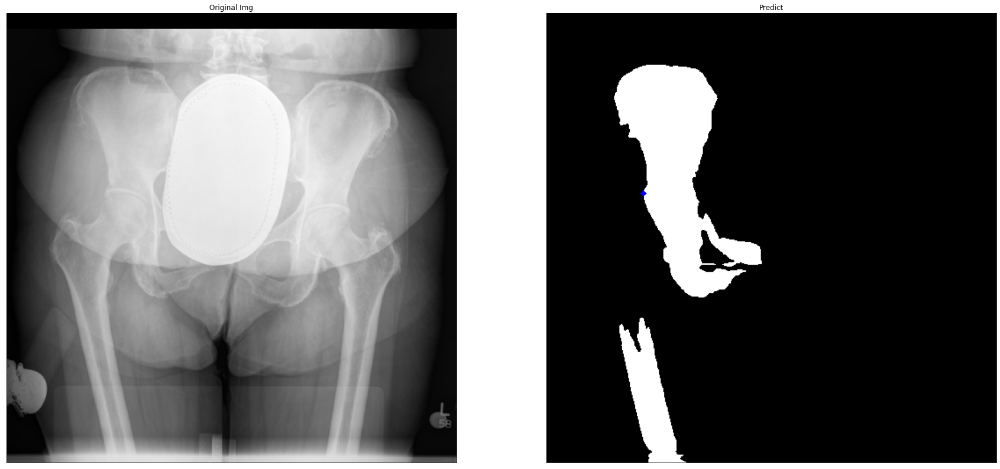

 40%|████      | 70/173 [00:38<00:56,  1.82it/s]

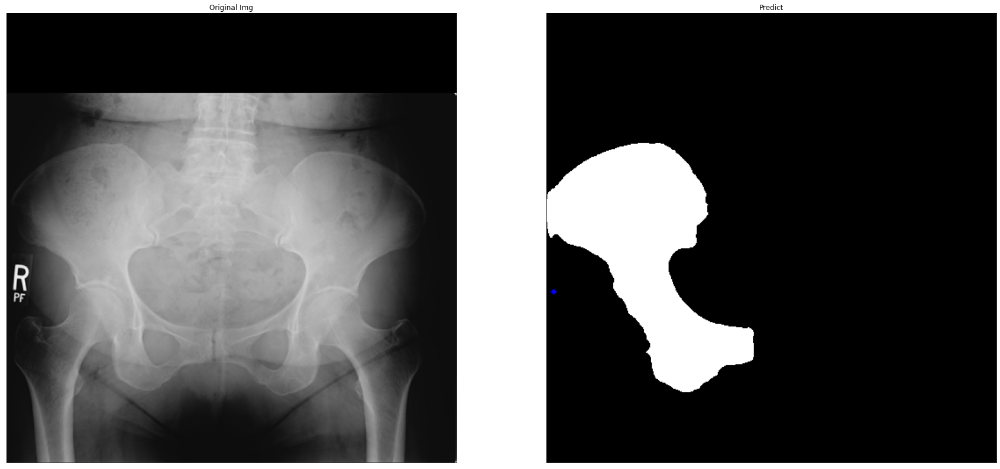

 41%|████      | 71/173 [00:39<01:09,  1.46it/s]

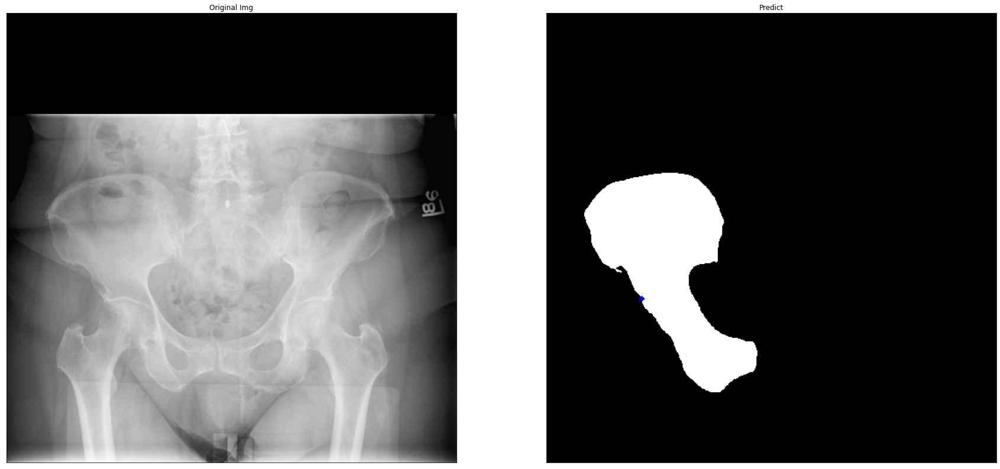

 42%|████▏     | 72/173 [00:40<01:04,  1.56it/s]

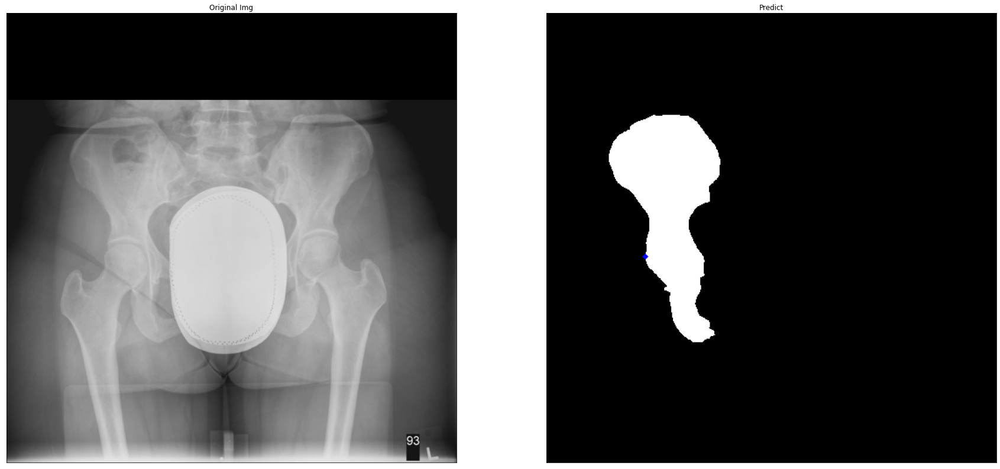

 42%|████▏     | 73/173 [00:40<01:00,  1.64it/s]

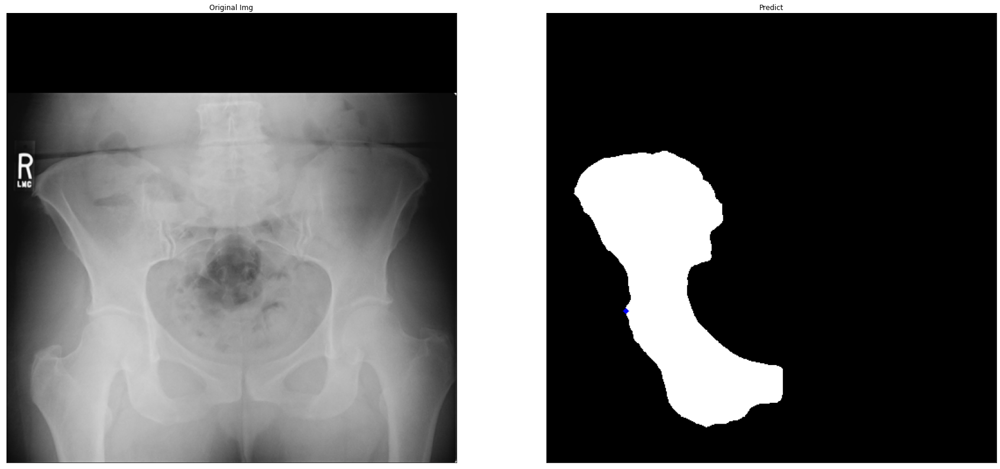

 43%|████▎     | 74/173 [00:41<00:59,  1.68it/s]

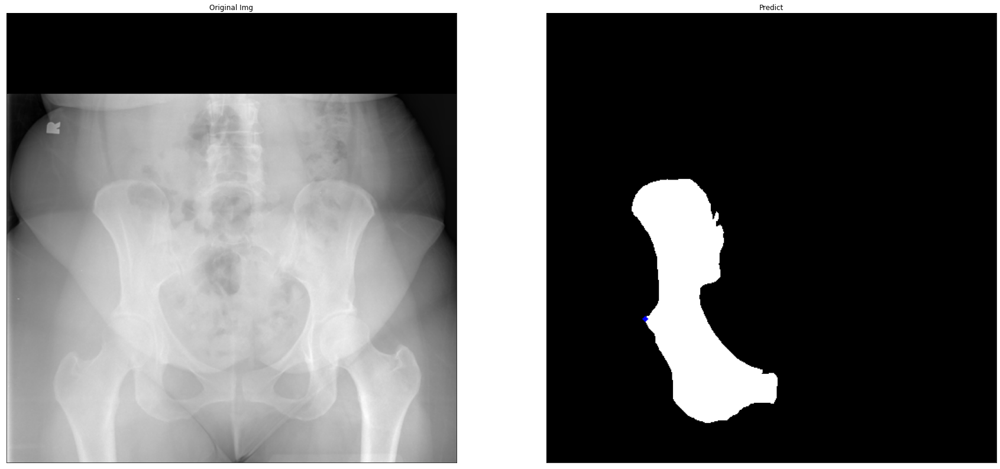

 43%|████▎     | 75/173 [00:42<00:57,  1.71it/s]

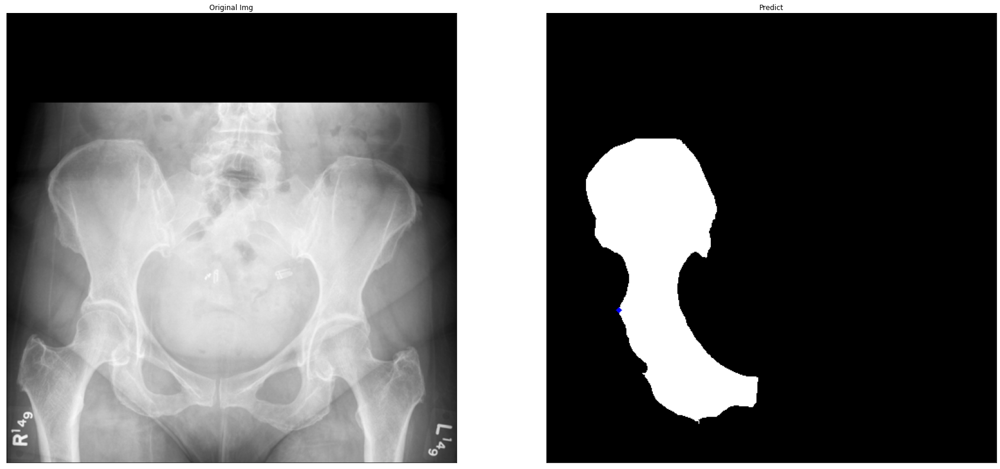

 44%|████▍     | 76/173 [00:42<00:55,  1.73it/s]

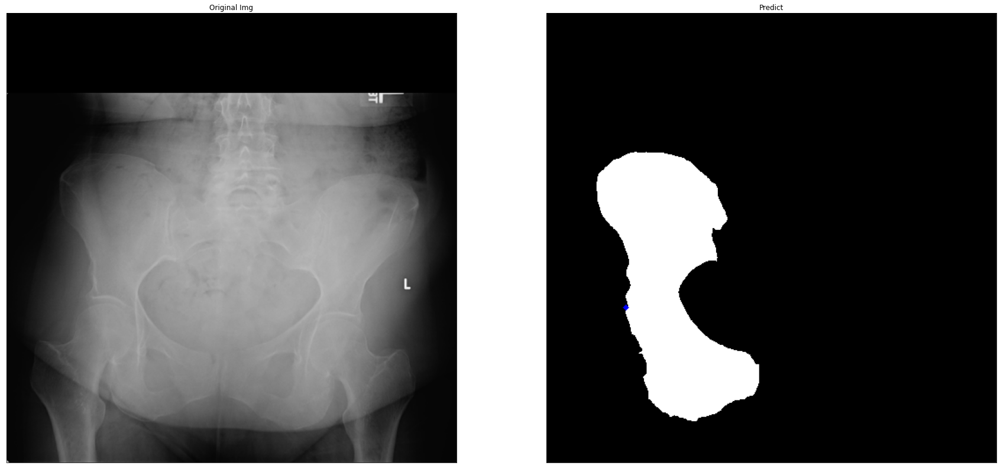

 45%|████▍     | 77/173 [00:43<00:54,  1.75it/s]

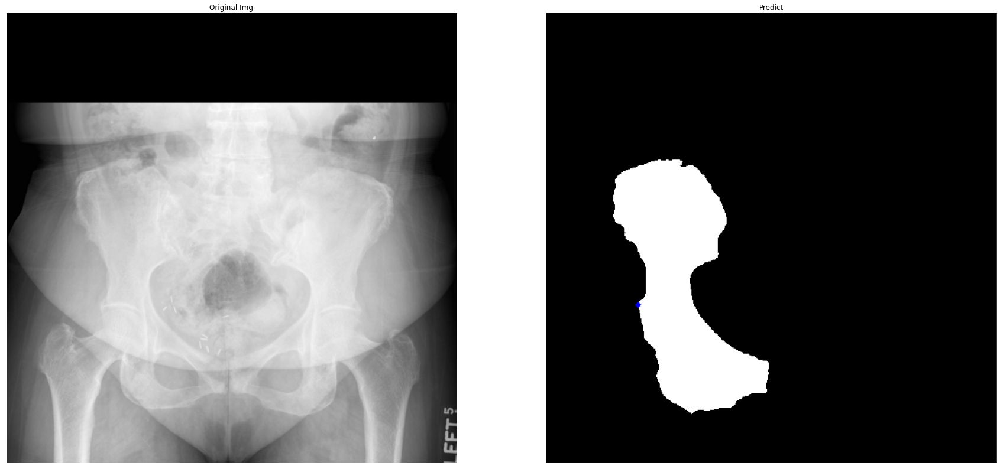

 45%|████▌     | 78/173 [00:43<00:54,  1.75it/s]

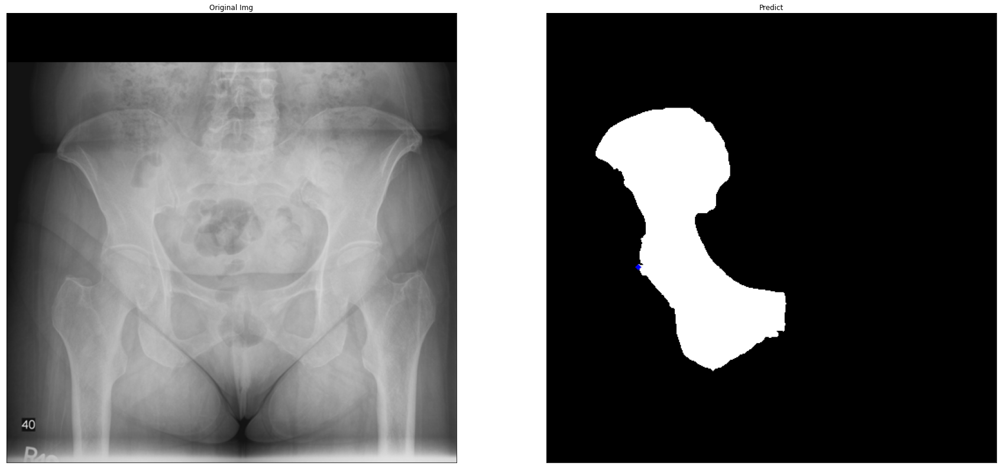

 46%|████▌     | 79/173 [00:44<00:53,  1.75it/s]

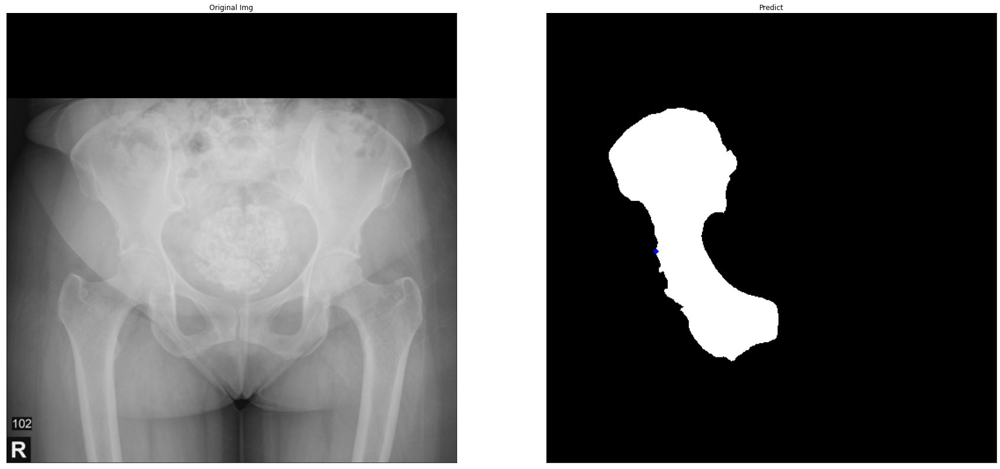

 46%|████▌     | 80/173 [00:44<00:52,  1.78it/s]

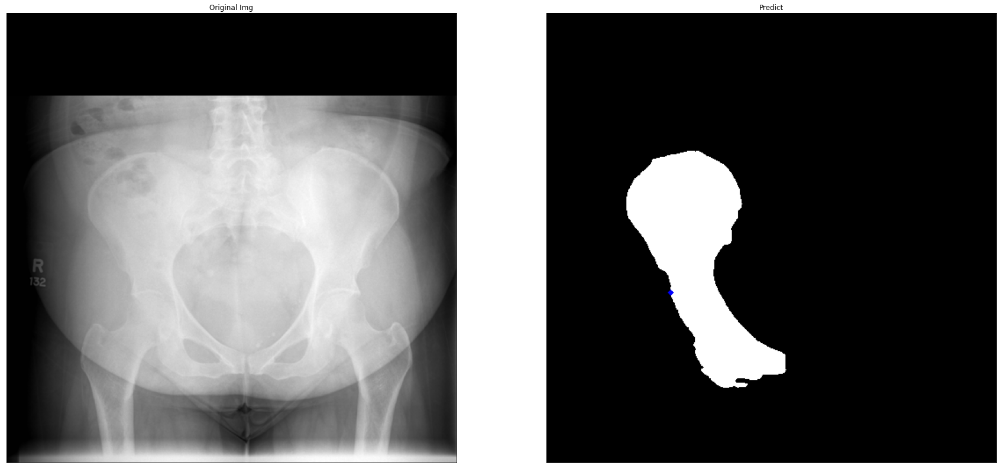

 47%|████▋     | 81/173 [00:45<00:51,  1.80it/s]

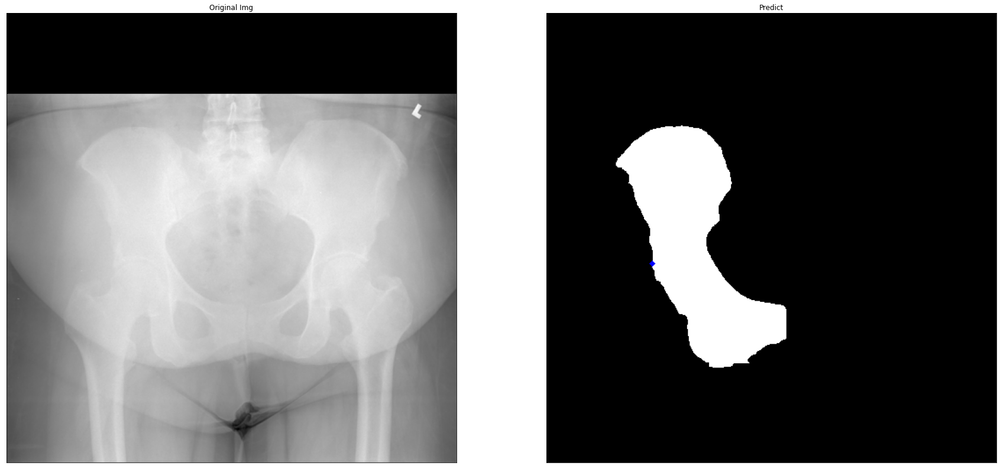

 47%|████▋     | 82/173 [00:45<00:50,  1.81it/s]

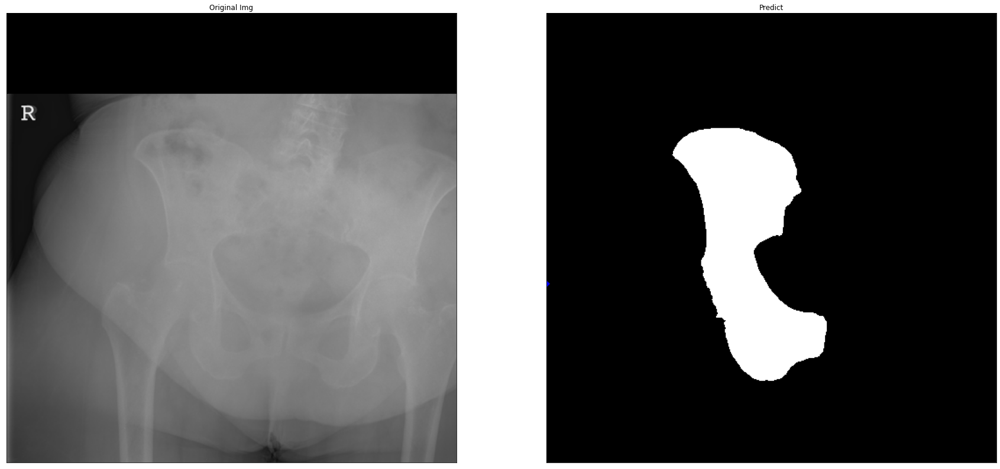

 48%|████▊     | 83/173 [00:46<00:49,  1.84it/s]

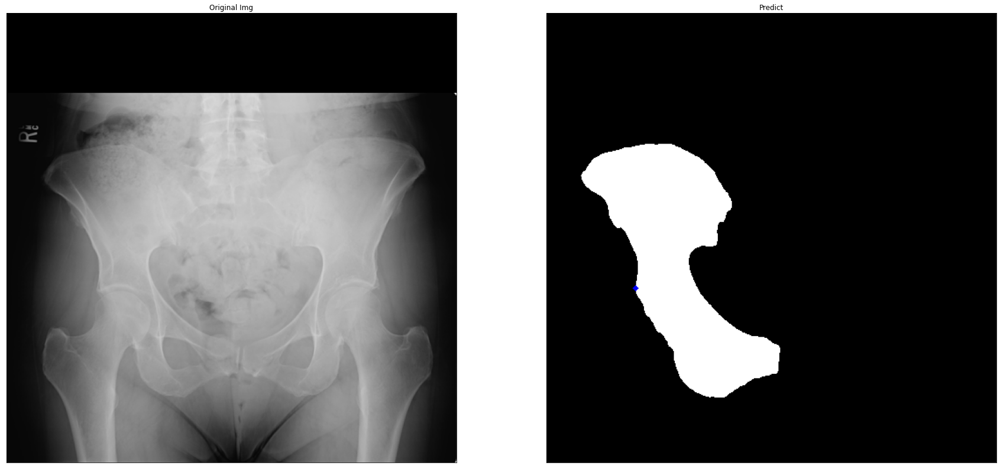

 49%|████▊     | 84/173 [00:47<00:50,  1.77it/s]


KeyboardInterrupt: 

In [460]:
for idx in tqdm(range(len(xray_lst))):
    xray_path = xray_lst[idx]
    xray = np.array(Image.open(xray_path).convert("RGB"))
    

    lhip_path = l_hip_lst[idx]
    rhip_path = r_hip_lst[idx]

    mask = np.array(Image.open(lhip_path).convert("RGB"))
    pnt1 = draw_point(mask, l_hip_lat_lst[idx])

    visualize(
            original_img=xray, 
            predict=pnt1
        )

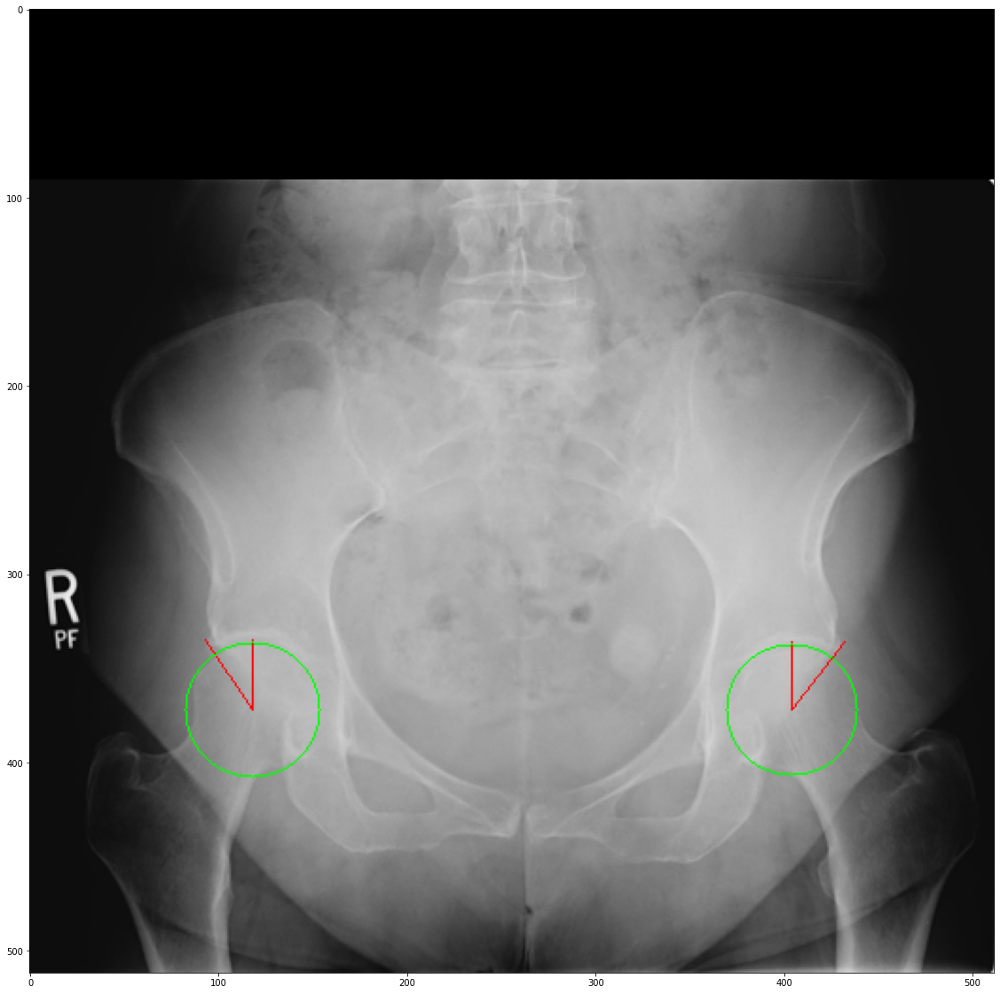

In [486]:
idx = 1
xray_path = xray_lst[idx]
mask_path = femur_lst[idx]
xray = np.array(Image.open(xray_path).convert("RGB"))
mask = np.array(Image.open(mask_path).convert("RGB"))*255

l_center = l_fcenter_lst[idx][0][0]
r_center = r_fcenter_lst[idx][0][0]
fcenter = [l_center, r_center]

# fcenter_lst.append(fcenter)
l_hiplat, r_hiplat = find_hiplat(fcenter, xray_path)

line1 = draw_line(xray, l_center[:-1], [l_center[0], l_hiplat[1]])
line2 = draw_line(line1, l_center[:-1], l_hiplat)

line3 = draw_line(line2, r_center[:-1], [r_center[0], r_hiplat[1]])
line4 = draw_line(line3, r_center[:-1], r_hiplat)


l_width = l_center[0] - l_hiplat[0]
l_height = l_center[1] - l_hiplat[1]

r_width = r_center[0] - r_hiplat[0]
r_height = r_center[1] - r_hiplat[1]

l_angle = math.degrees(math.atan(l_width/l_height))
r_angle = math.degrees(math.atan(r_width/r_height))

# angle_lst.append([l_angle, r_angle])


for i in fcenter:
    #Draw outer circle (blue)
    cv2.circle(line4, (i[0], i[1]), i[2], (0, 255, 0), 1)
    
plt.imshow(line4)
plt.show()

In [437]:
import pandas as pd

In [438]:
df = pd.read_csv("xray/Center_edge_angle_20211106.csv")

In [439]:
df

,fname,Right_CEA,Left_CEA
0,9004905.png,46.30,43.75
1,9021102.png,43.93,33.04
2,9021791.png,38.29,41.54
3,9030718.png,46.06,49.00
4,9041946.png,40.57,33.75
...,...,...,...
167,9973722.png,41.12,35.27
168,9976720.png,41.51,44.45
169,9977206.png,40.77,34.48
170,9982186.png,46.55,51.76


In [475]:
df["Right_predict"] = l_angle_lst
df["Left_predict"] = r_angle_lst

In [476]:
df

,fname,Right_CEA,Left_CEA,Right_predict,Left_predict
0,9004905.png,46.30,43.75,39.610688,38.884496
1,9021102.png,43.93,33.04,34.045937,37.874984
2,9021791.png,38.29,41.54,37.146687,43.090848
3,9030718.png,46.06,49.00,42.184443,43.152390
4,9041946.png,40.57,33.75,37.116861,33.023868
...,...,...,...,...,...
167,9973722.png,41.12,35.27,30.529706,34.777831
168,9976720.png,41.51,44.45,37.874984,47.726311
169,9977206.png,40.77,34.48,41.531771,40.156000
170,9982186.png,46.55,51.76,42.357455,36.384352


In [478]:
df.to_csv("Predict_CEA_20211112.csv", index=False)

In [440]:
df.Right_CEA

0      46.30
1      43.93
2      38.29
3      46.06
4      40.57
       ...  
167    41.12
168    41.51
169    40.77
170    46.55
171    69.69
Name: Right_CEA, Length: 172, dtype: float64

In [471]:
l_angle_lst = []
r_angle_lst = []
for idx in range(len(angle_lst)):
    if idx == 134:
        continue
    l_angle_lst.append(angle_lst[idx][0])
    r_angle_lst.append(-angle_lst[idx][1])

In [442]:
from sklearn.metrics import mean_absolute_error 

In [443]:
def MAPE(y_test, y_pred):
    return np.mean(np.abs((y_test - y_pred) / y_test)) * 100 

In [472]:
l_maperr = MAPE(df.Right_CEA, l_angle_lst)
l_maerr = mean_absolute_error(df.Right_CEA, l_angle_lst)
print(l_maperr, l_maerr)

14.394257853582381 6.151369189525466


In [473]:
r_maperr = MAPE(df.Left_CEA, r_angle_lst)
r_maerr = mean_absolute_error(df.Left_CEA, r_angle_lst)
print(r_maperr, r_maerr)

11.865630117064464 4.832956460494972


In [474]:
(l_maperr + r_maperr)/2

13.129943985323422

In [477]:
(l_maerr + r_maerr)/2

5.492162825010219

In [315]:
xray_lst[-1]

'xray/png_512/9989309.png'

In [310]:
np.argmax(l_angle_lst)

70

In [314]:
angle_lst[70]

[71.74810416292145, -38.659808254090095]

In [269]:
np.argmax()

[[39.61068824002659, -38.884496433714595],
 [34.04593735660166, -37.874983651098205],
 [37.14668669802178, -43.09084756700362],
 [42.18444331578877, -43.15238973400541],
 [37.116860683270275, -33.02386755579665],
 [34.11447294534126, -35.706691400602885],
 [39.8055710922652, -34.5085229876684],
 [38.659808254090095, -44.028978068920836],
 [40.763605200941164, -34.11447294534126],
 [37.47617956136138, -40.60129464500447],
 [30.141385552075345, -30.699722550814414],
 [48.71528910542877, -38.29016319224307],
 [37.64762064010765, -39.8055710922652],
 [36.119340849479755, -38.08877288097532],
 [41.6335393365702, -42.27368900609374],
 [32.15229514128234, -39.0938588862295],
 [30.46554491945988, -34.07719528013074],
 [37.116860683270275, -40.60129464500447],
 [41.423665625002656, -45.93919094573558],
 [34.33021719550333, -38.659808254090095],
 [25.942295489871675, -38.23382517744694],
 [23.198590513648185, -30.173520029644333],
 [38.45370921670597, -36.86989764584402],
 [44.14490260373328, -3

In [25]:
width = fcenter[0][0][0] - l_hiplat[0]
height = fcenter[0][0][1] - l_hiplat[1]

In [27]:
math.degrees(math.atan(width/height))

40.91438322002513

In [37]:
xray = np.array(Image.open(xray_path).convert("RGB"))

In [38]:
line1 = draw_line(xray, fcenter[0][0][:-1], [fcenter[0][0][0], l_hiplat[1]])
line2 = draw_line(line1, fcenter[0][0][:-1], l_hiplat)

line3 = draw_line(line2, fcenter[0][1][:-1], [fcenter[0][1][0], r_hiplat[1]])
line4 = draw_line(line3, fcenter[0][1][:-1], r_hiplat)

In [39]:
mask = np.array(Image.open(mask_path))

In [40]:
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
for c in contours:
    cv2.drawContours(line4,[c],-1,(0, 255, 0),1)

In [41]:
for i in fcenter[0, :]:
    #Draw outer circle (blue)
    cv2.circle(line4, (i[0], i[1]), i[2], (0, 255, 0), 1)

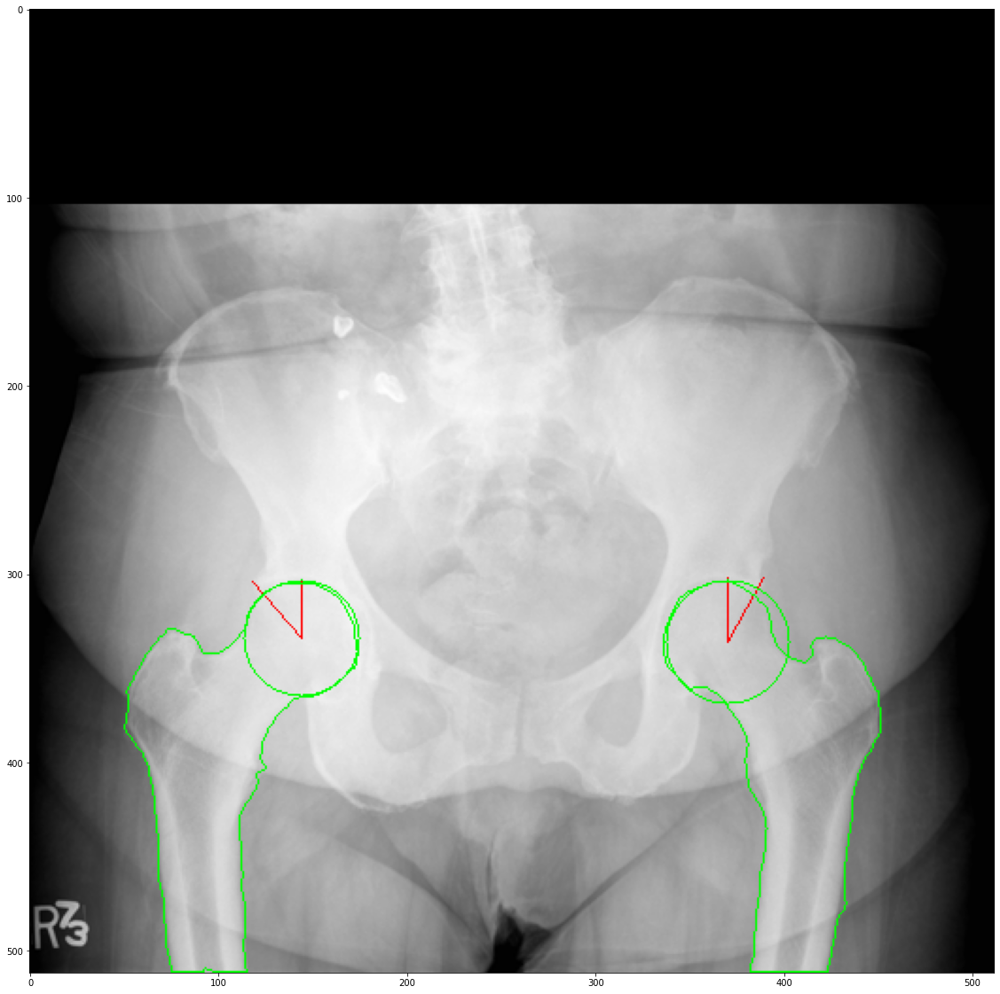

In [43]:
plt.imshow(line4)

In [373]:
a = draw_point(xray, r_hiplat)

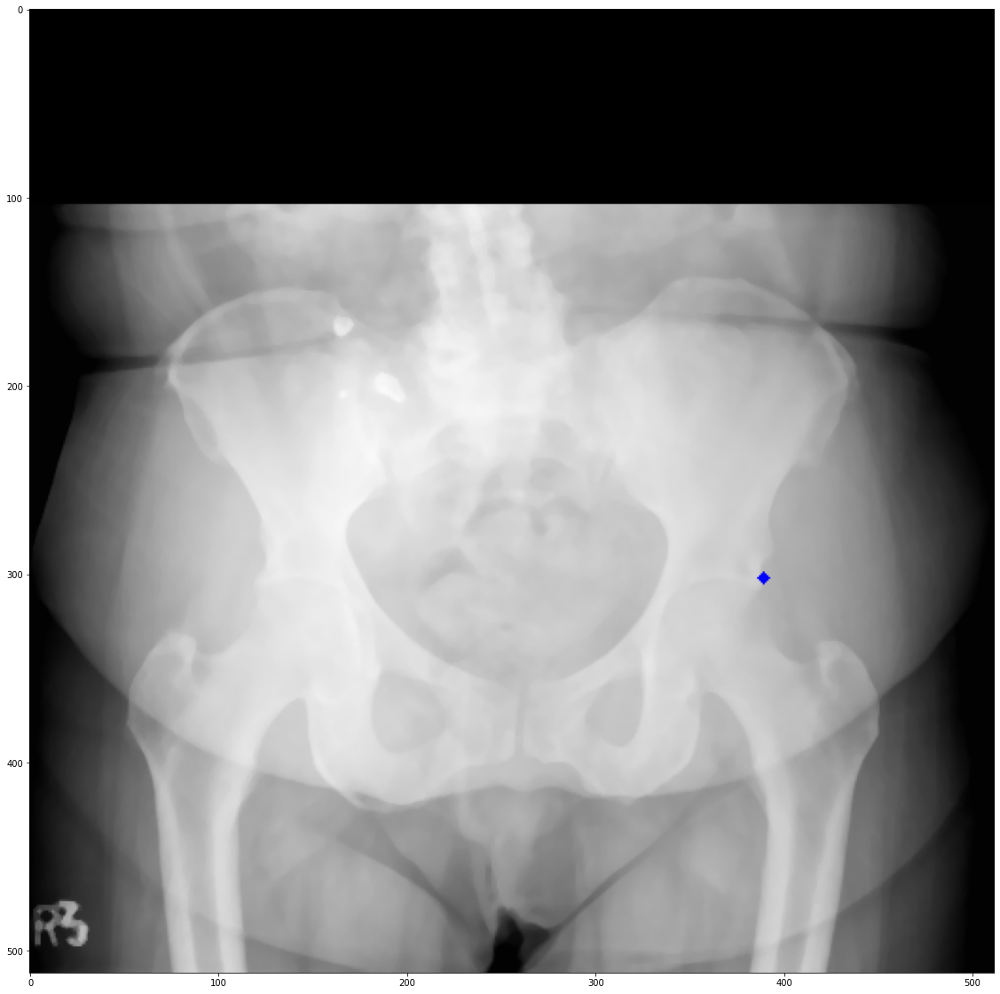

In [374]:
ptl

In [420]:
#Hoff circle detection
img, cimg = load_img(mask_lst[0], mask_mul=255)
_, ximg = load_img(xray_lst[0])

xray = ximg.copy()

circles = cv2.HoughCircles(img, cv2.HOUGH_GRADIENT, 1, 20,
                           param1=10, param2=15, minRadius=0, maxRadius=0)
#If the minimum circle radius is not set properly, false circles may also be detected
# circles = cv2.HoughCircles(img, cv2.HOUGH_GRADIENT, 1, 20,
#                            param1=50, param2=40, minRadius=0, maxRadius=0)
# circles = cv2.HoughCircles(img, cv2.HOUGH_GRADIENT, 1, 20,
#                            param1=50, param2=30, minRadius=10, maxRadius=0)

circles = np.uint16(np.around(circles))

c_lst = []
for c in circles[0]:
    if c[-1] > 60:
        continue
    c_lst.append(c)
    c_arr = np.array([c_lst])

print(len(c_arr[0]))
print(c_arr)
for i in c_arr[0, :]:
    #Draw outer circle (blue)
    cv2.circle(cimg, (i[0], i[1]), i[2], (0, 255, 0), 2)
    cv2.circle(ximg, (i[0], i[1]), i[2], (0, 255, 0), 2)
    #Draw Center (red)
    cv2.circle(cimg, (i[0], i[1]), 2, (0, 0, 255), 3)
    cv2.circle(ximg, (i[0], i[1]), 2, (0, 0, 255), 3)

2
[[[144 334  31]
  [370 336  33]]]


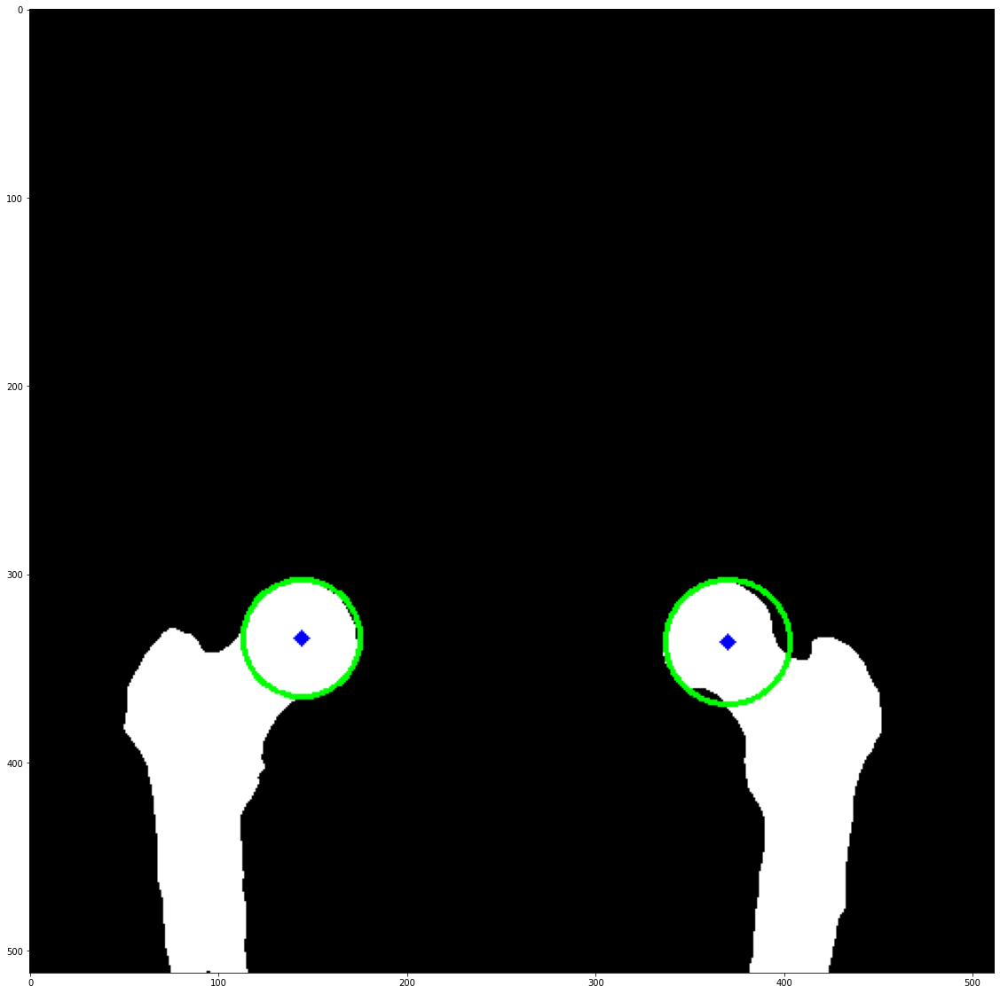

In [200]:
plt.imshow(cimg)

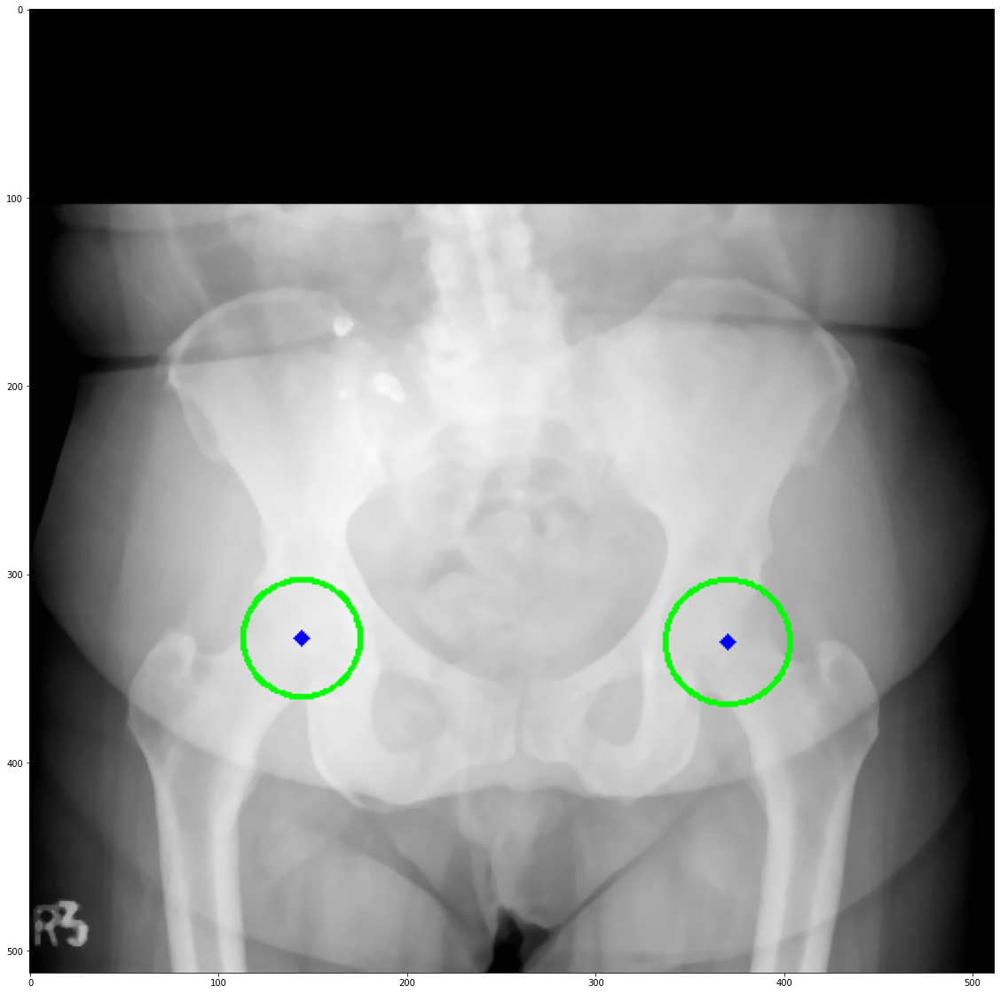

In [201]:
plt.imshow(ximg)

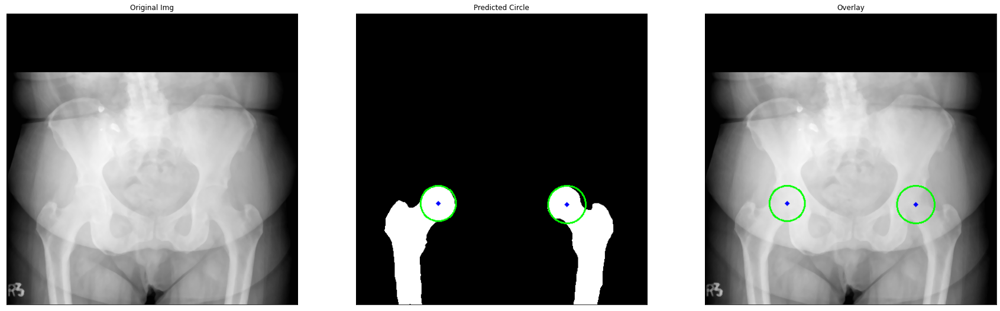

In [167]:
visualize(
            original_img=xray, 
            predicted_circle= cimg, 
            overlay= ximg
        )

In [188]:
org_lst = []
cimg_lst = []
ximg_lst = []

for idx in range(len(mask_lst)):
    #Hoff circle detection
    img, cimg = load_img(mask_lst[idx], mask_mul=255)
    _, ximg = load_img(xray_lst[idx])

    xray = ximg.copy()

    circles = cv2.HoughCircles(img, cv2.HOUGH_GRADIENT, 1, 80,
                               param1=10, param2=13, minRadius=0, maxRadius=0)
    #If the minimum circle radius is not set properly, false circles may also be detected
    # circles = cv2.HoughCircles(img, cv2.HOUGH_GRADIENT, 1, 20,
    #                            param1=50, param2=40, minRadius=0, maxRadius=0)
    # circles = cv2.HoughCircles(img, cv2.HOUGH_GRADIENT, 1, 20,
    #                            param1=50, param2=30, minRadius=10, maxRadius=0)

    circles = np.uint16(np.around(circles))

    c_lst = []
    for c in circles[0]:
        if c[-1] > 50:
            continue
        elif c[-1] < 20:
            continue
        c_lst.append(c)
        c_arr = np.array([c_lst])

    print(len(c_arr[0]))
#     print(c_arr)
    for i in c_arr[0, :]:
        #Draw outer circle (blue)
        cv2.circle(cimg, (i[0], i[1]), i[2], (0, 255, 0), 2)

        #Draw Center (red)
        cv2.circle(cimg, (i[0], i[1]), 2, (0, 0, 255), 3)

    for i in c_arr[0, :]:
        #Draw outer circle (blue)
        cv2.circle(ximg, (i[0], i[1]), i[2], (0, 255, 0), 2)

        #Draw Center (red)
        cv2.circle(ximg, (i[0], i[1]), 2, (0, 0, 255), 3)
    
    org_lst.append(xray)
    cimg_lst.append(cimg)
    ximg_lst.append(ximg)

2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2
2


TypeError: loop of ufunc does not support argument 0 of type NoneType which has no callable rint method

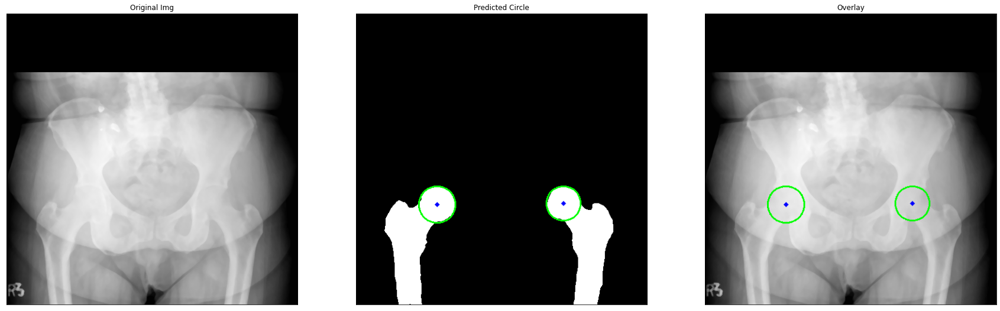

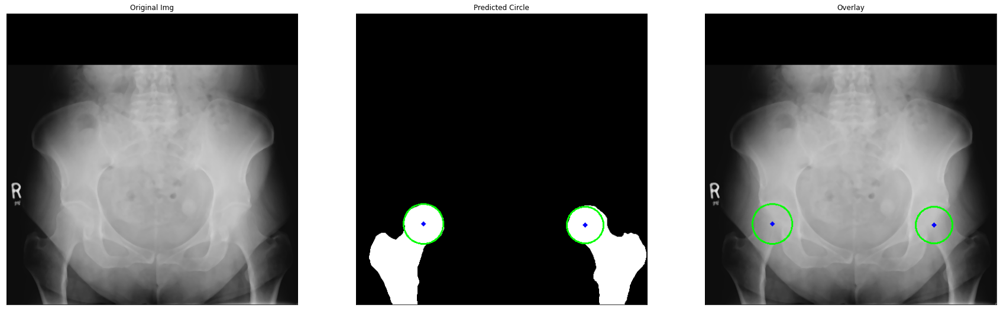

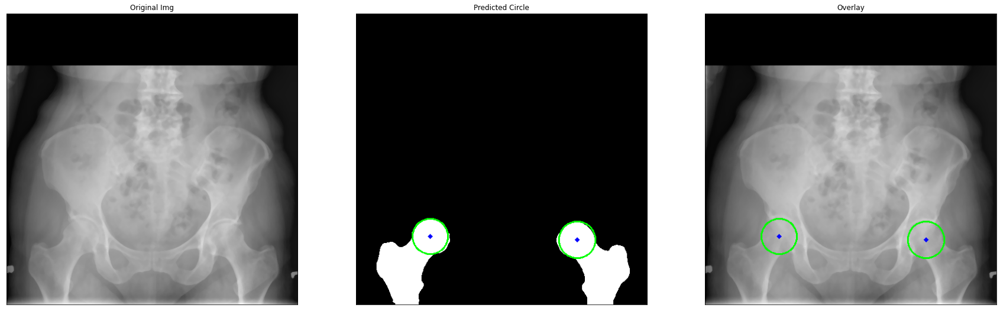

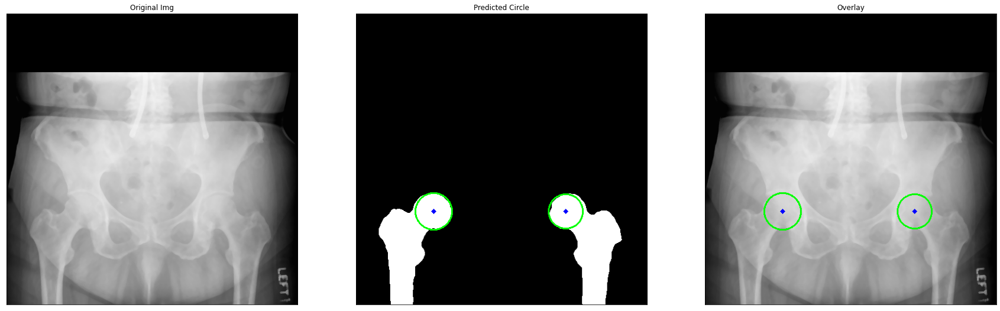

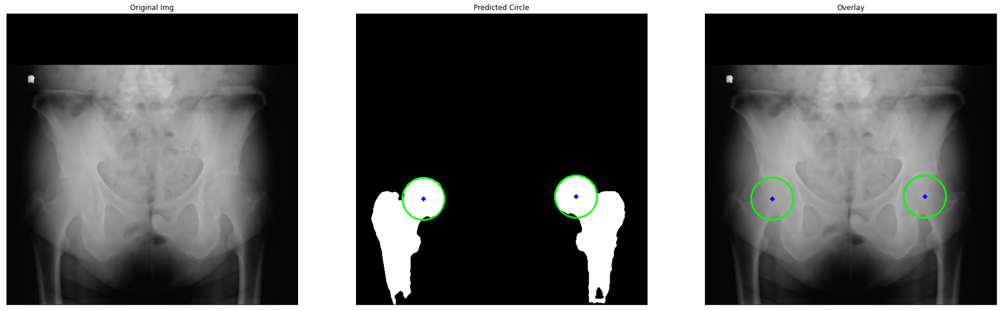

...

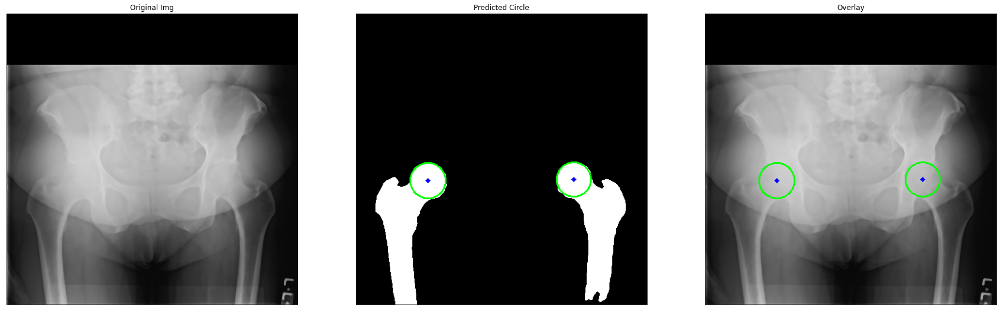

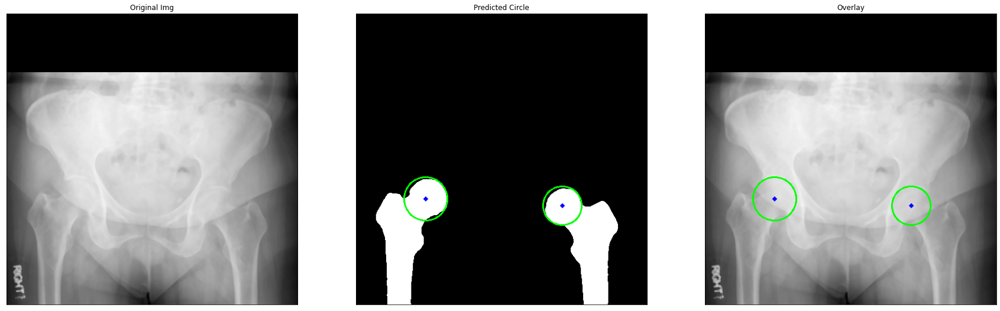

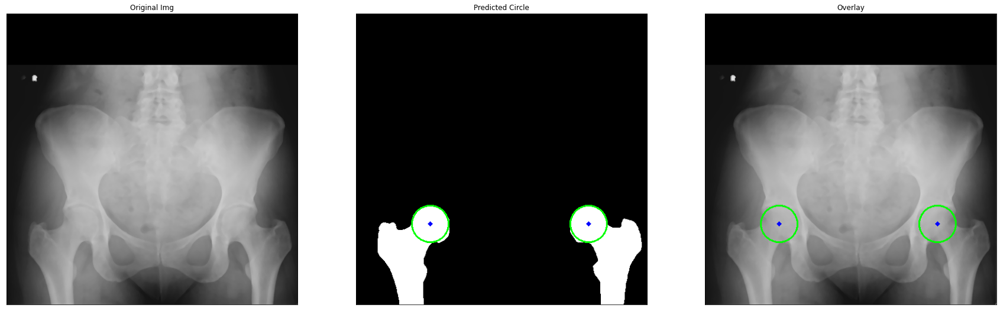

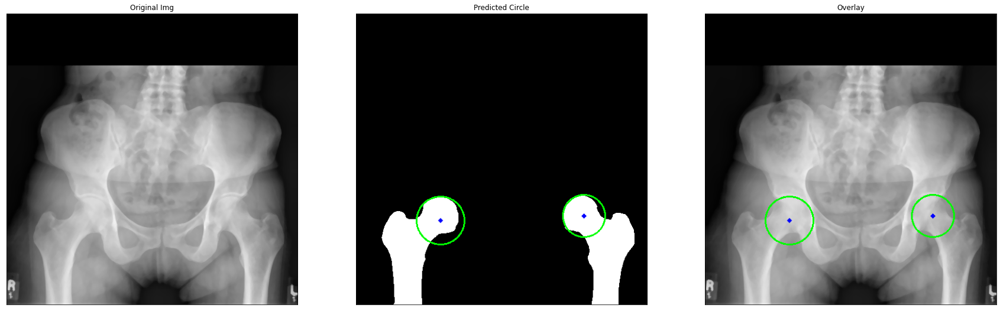

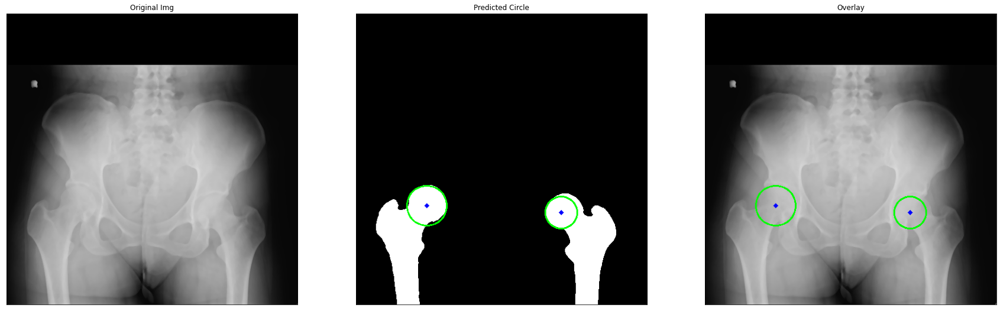

IndexError: list index out of range

In [189]:
for idx in range(len(mask_lst)):

    visualize(
                original_img=org_lst[idx], 
                predicted_circle= cimg_lst[idx], 
                overlay= ximg_lst[idx]
            )

In [203]:
f_lst = []
for fname in mask_lst:
    f_lst.append(fname.split('/')[-1])

In [204]:
import pandas as pd
df = pd.DataFrame({'fname': f_lst})

In [206]:
df.to_csv("file_lst.csv", index=False)